<a href="https://colab.research.google.com/github/Rjpiit/ML335_assignment4/blob/main/ML335_Q1_assignment4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import files
import zipfile
import os

# Step 1: Upload the zip file (you can skip this if it's already uploaded)
# uploaded = files.upload()

# Step 2: Extract the zip file
zip_file_path = '/content/Dataset.zip'  # Adjust the path if needed

# Ensure the file exists
if os.path.exists(zip_file_path):
    with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
        zip_ref.extractall('/content/Dataset')  # Extract to /content/Dataset directory
    print("Extraction complete.")
else:
    print("Zip file not found.")

# Step 3: Check the contents of the extracted directory
extracted_folder = '/content/Dataset'  # Location where your files were extracted
folder = os.path.join(extracted_folder, 'train', 'raccoon')  # Adjust path as needed

# Ensure the folder exists
if not os.path.exists(folder):
    print(f"Directory not found: {folder}")
else:
    # Step 4: Get a sorted list of all image filenames in the directory
    image_files = sorted(os.listdir(folder))

    # Step 5: Plot the first 80 images
    import matplotlib.pyplot as plt
    import matplotlib.image as mpimg

    plt.figure(figsize=(10, 10))
    for i, image_file in enumerate(image_files[:80]):
        img_path = os.path.join(folder, image_file)
        img = mpimg.imread(img_path)
        plt.subplot(8, 10, i + 1)
        plt.imshow(img)
        plt.axis('off')

    plt.tight_layout()
    plt.show()


Extraction complete.
Directory not found: /content/Dataset/train/raccoon


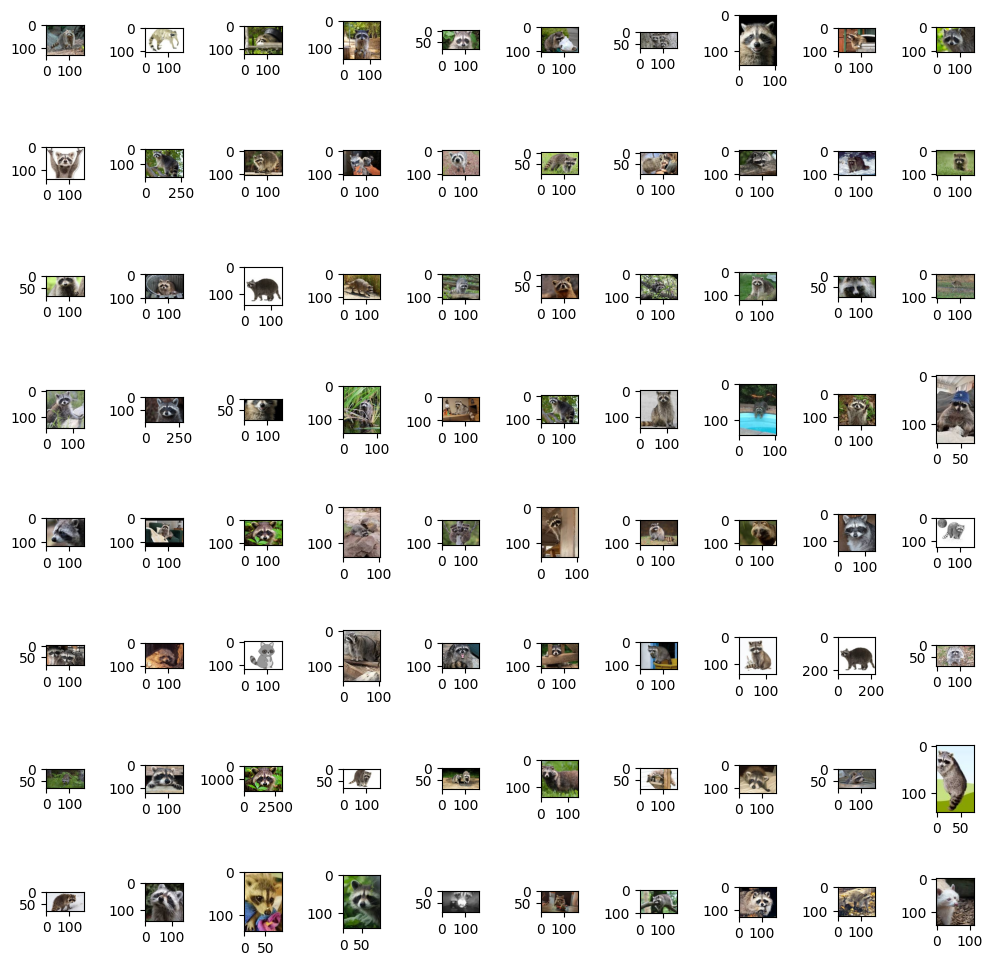

In [2]:
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Path to your raccoon folder in Colab
folder = '/content/Dataset/Dataset/train/raccoon'

# Check if the folder exists
if not os.path.exists(folder):
    print(f"Directory not found: {folder}")
else:
    # Get a sorted list of all image filenames in the directory
    image_files = sorted(os.listdir(folder))

    # Plot the first 80 images
    plt.figure(figsize=(10, 10))
    for i, image_file in enumerate(image_files[:80]):
        img_path = os.path.join(folder, image_file)
        img = mpimg.imread(img_path)
        plt.subplot(8, 10, i + 1)
        plt.imshow(img)
        plt.axis()

    plt.tight_layout()
    plt.show()


**VGG (1 BLOCK)**

In [3]:
import sys
import time
from matplotlib import pyplot
from keras.utils import to_categorical
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Input
from keras.optimizers import SGD
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import TensorBoard

# Define the VGG-like 1 block model
def define_model():
    model = Sequential()

    # Input layer to define input shape
    model.add(Input(shape=(200, 200, 3)))  # Define input shape here

    # Block 1 - One convolutional block (2 Conv layers + MaxPooling)
    model.add(Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same'))
    model.add(Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same'))
    model.add(MaxPooling2D((2, 2)))  # Max pooling after the convolutional layers

    # Flatten the output before feeding to fully connected layers
    model.add(Flatten())

    # Fully connected layers (dense layers)
    model.add(Dense(128, activation='relu', kernel_initializer='he_uniform'))
    model.add(Dense(1, activation='sigmoid'))  # Output layer for binary classification

    # Compile the model
    opt = SGD(learning_rate=0.001, momentum=0.9)
    model.compile(optimizer=opt, loss='binary_crossentropy', metrics=['accuracy'])

    return model

# Plot diagnostic learning curves
def summarize_diagnostics(history):
    # Plot loss
    pyplot.subplot(211)
    pyplot.title('Cross Entropy Loss')
    pyplot.plot(history.history['loss'], color='blue', label='train')
    pyplot.plot(history.history['val_loss'], color='orange', label='test')
    # Add legend
    pyplot.legend()

    # Plot accuracy
    pyplot.subplot(212)
    pyplot.title('Classification Accuracy')
    pyplot.plot(history.history['accuracy'], color='blue', label='train')
    pyplot.plot(history.history['val_accuracy'], color='orange', label='test')
    # Add legend
    pyplot.legend()

    # Save plot to file
    filename = sys.argv[0].split('/')[-1]
    pyplot.savefig(filename + '_plot.png')
    pyplot.show()
    pyplot.close()



Found 160 images belonging to 2 classes.
Found 40 images belonging to 2 classes.
Epoch 1/20


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


16/16 ━━━━━━━━━━━━━━━━━━━━ 9s 146ms/step - accuracy: 0.5564 - loss: 3.1879 - val_accuracy: 0.6250 - val_loss: 0.6000
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 49ms/step - accuracy: 0.7818 - loss: 0.5016 - val_accuracy: 0.7750 - val_loss: 0.4246
Epoch 3/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 51ms/step - accuracy: 0.8383 - loss: 0.4532 - val_accuracy: 0.8000 - val_loss: 0.4242
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 48ms/step - accuracy: 0.9198 - loss: 0.2728 - val_accuracy: 0.5750 - val_loss: 0.9186
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 50ms/step - accuracy: 0.8320 - loss: 0.4810 - val_accuracy: 0.8000 - val_loss: 0.3694
Epoch 6/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 49ms/step - accuracy: 0.9645 - loss: 0.1648 - val_accuracy: 0.6750 - val_loss: 0.5132
Epoch 7/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 51ms/step - accuracy: 0.9288 - loss: 0.2504 - val_accuracy: 0.8250 - val_loss: 0.4291
Epoch 8/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 56ms/step - accuracy: 0.9784 - loss: 0.1130 - val_accuracy: 0.9000 - val_loss: 0

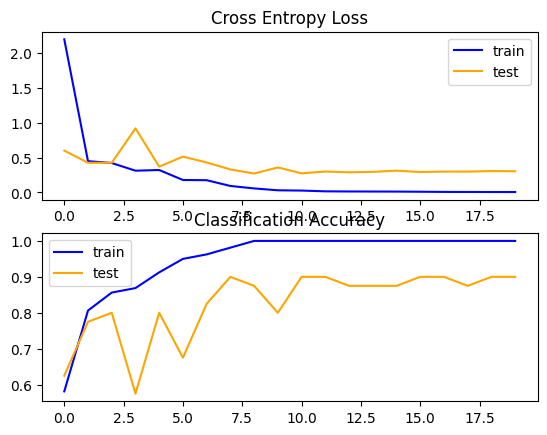

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


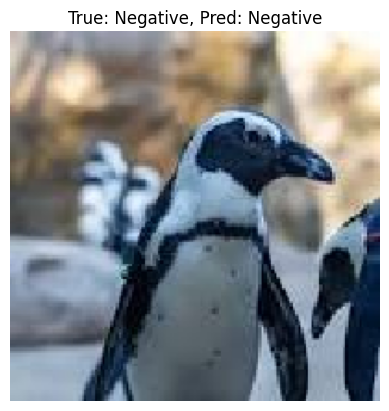

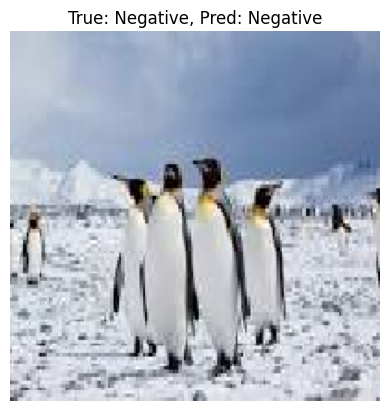

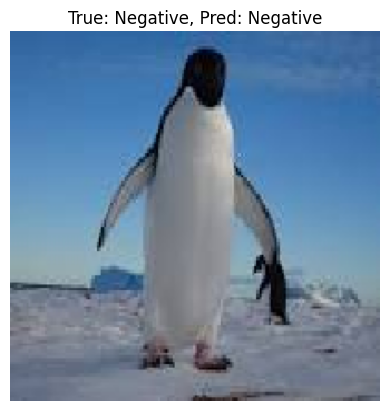

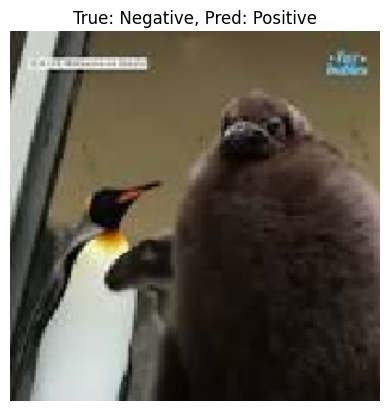

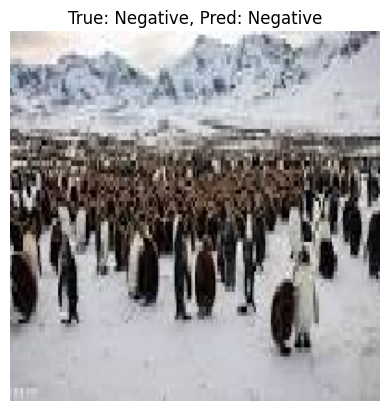

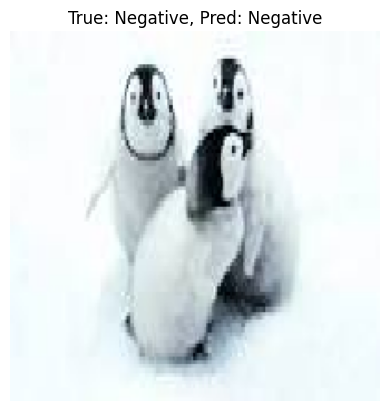

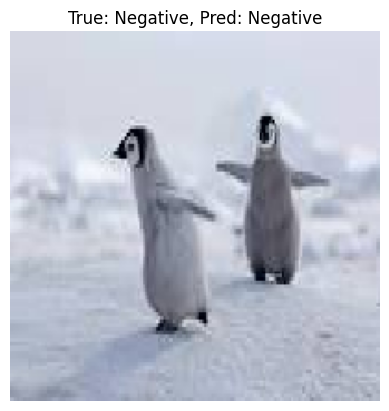

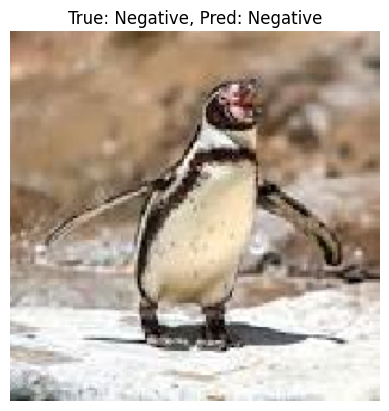

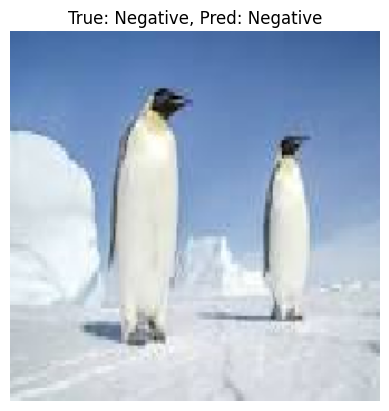

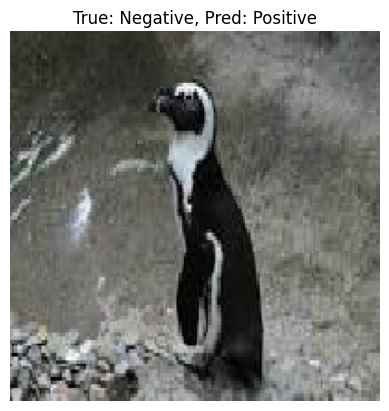

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


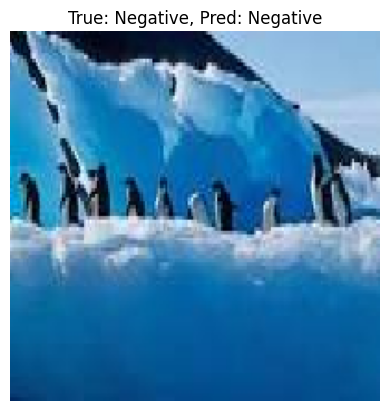

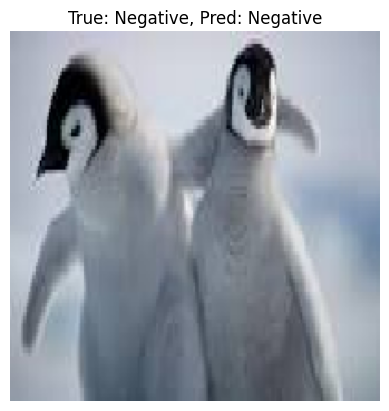

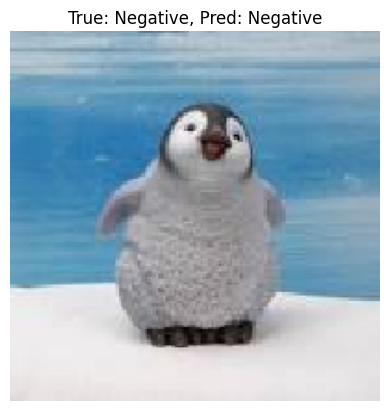

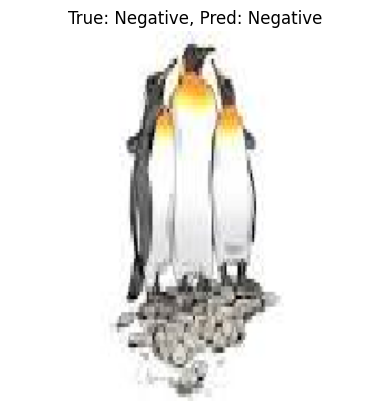

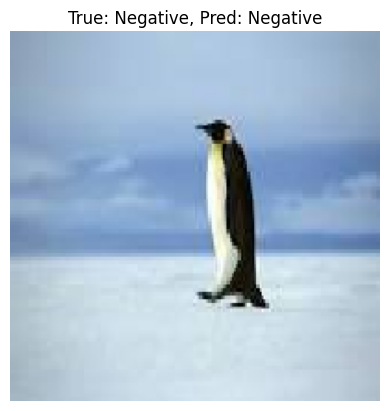

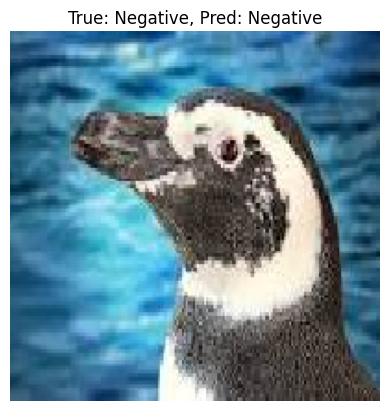

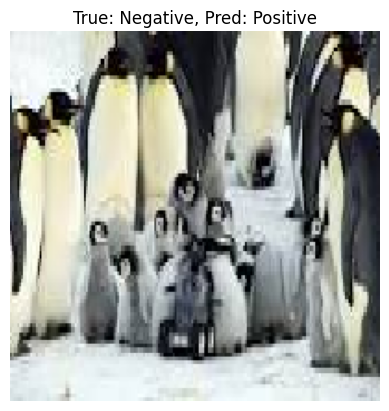

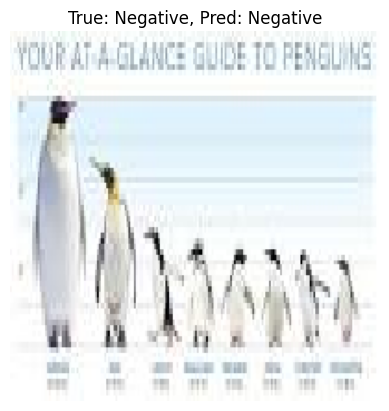

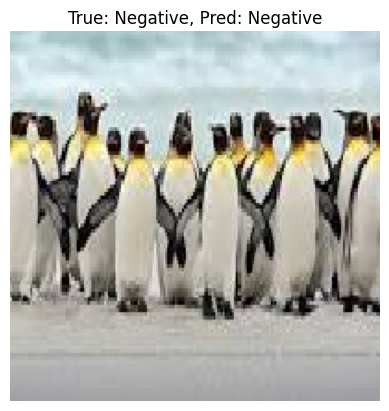

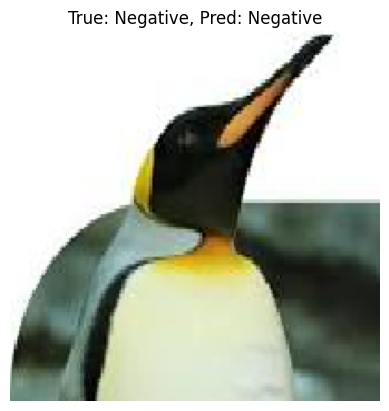

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


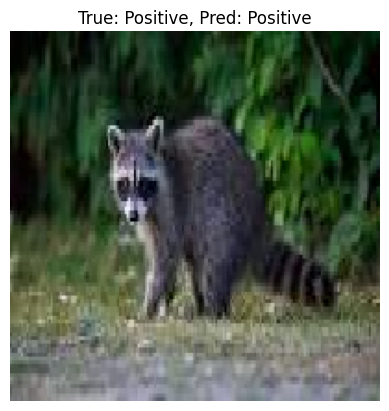

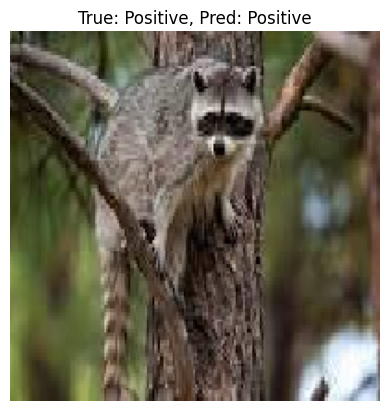

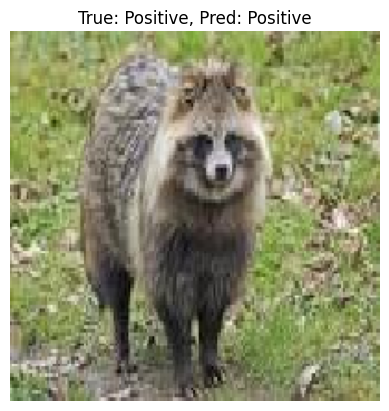

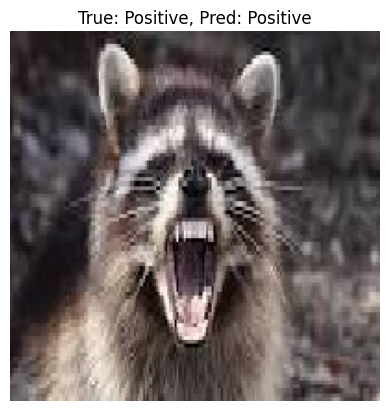

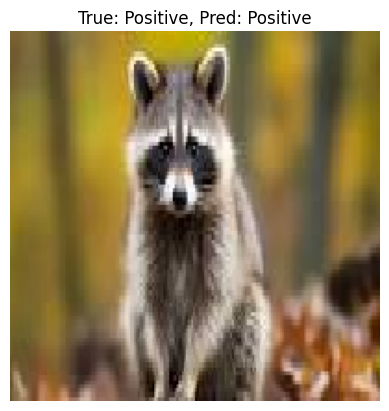

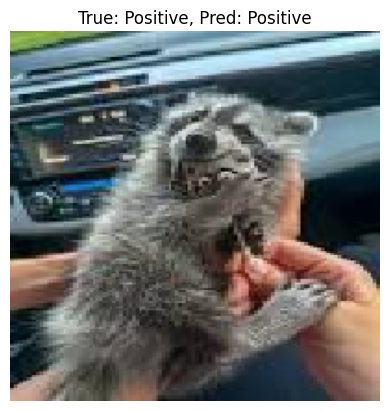

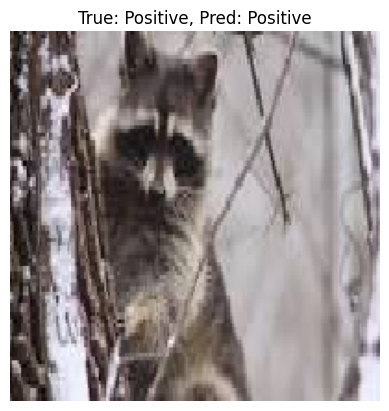

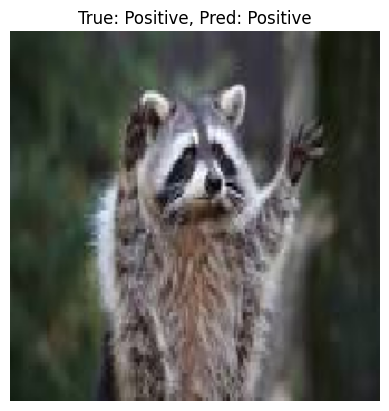

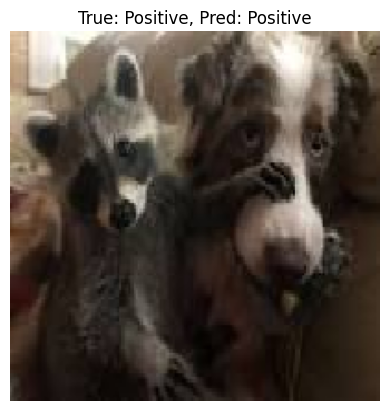

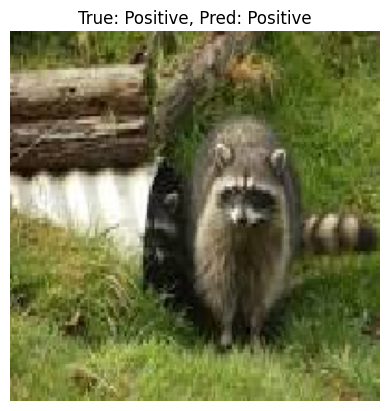

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


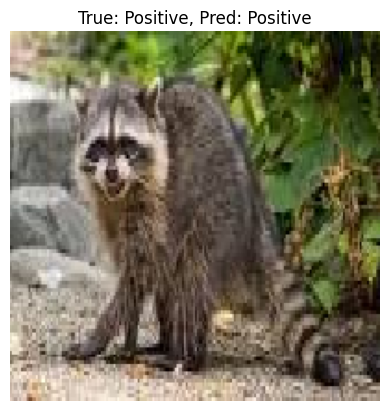

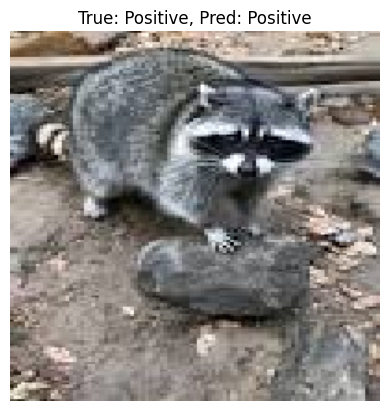

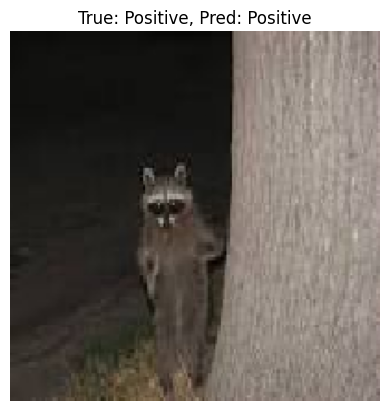

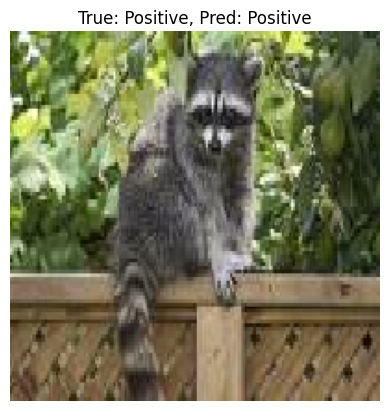

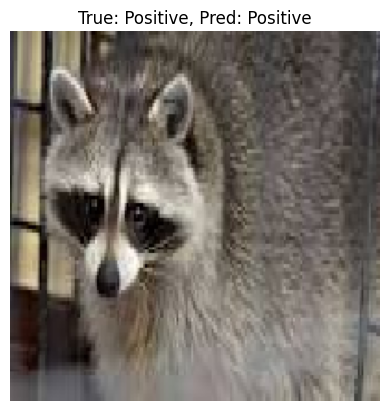

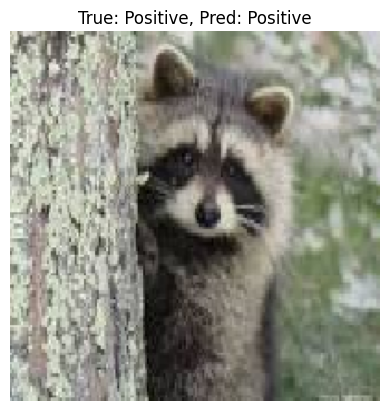

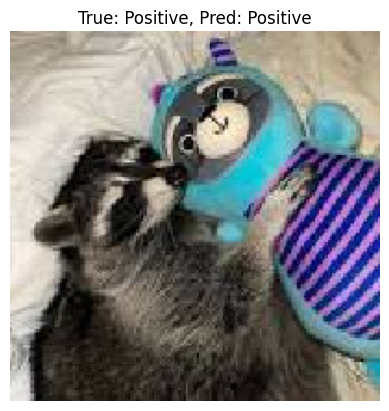

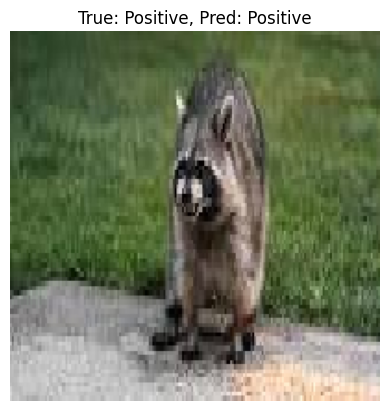

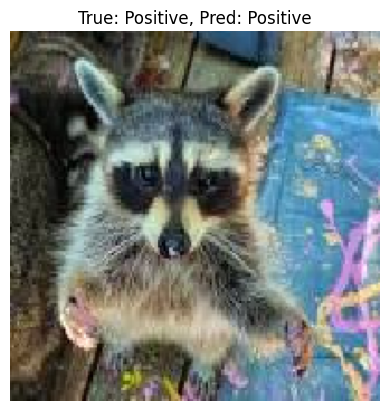

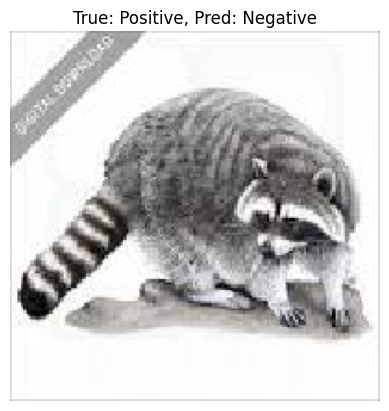

In [ ]:
def show_predictions(model, test_iterator):
    test_iterator.reset()
    for i in range(len(test_iterator)):
        images, labels = next(test_iterator)
        predictions = model.predict(images)
        for j in range(len(images)):
            pyplot.imshow(images[j])
            true_label = 'Positive' if labels[j] == 1 else 'Negative'
            predicted_label = 'Positive' if predictions[j] > 0.5 else 'Negative'
            pyplot.title(f"True: {true_label}, Pred: {predicted_label}")
            pyplot.axis('off')
            pyplot.show()

# Run the test harness for evaluating the model
def run_test_harness():
    # Define model
    model = define_model()

    # Create data generator
    datagen = ImageDataGenerator(rescale=1.0 / 255.0)

    # Prepare iterators
    train_it = datagen.flow_from_directory('/content/Dataset/Dataset/train',
                                           class_mode='binary', batch_size=10, target_size=(200, 200))
    test_it = datagen.flow_from_directory('/content/Dataset/Dataset/test',
                                          class_mode='binary', batch_size=10, target_size=(200, 200),
                                          shuffle=False)  # Shuffle disabled for consistent predictions

    # Start time
    start_time = time.time()

    # Fit model
    history = model.fit(train_it, validation_data=test_it, epochs=20, verbose=1)

    # End time
    end_time = time.time()

    # Calculate training time
    training_time = end_time - start_time
    print('Training time: %.3f seconds' % training_time)

    # Evaluate model
    _, acc = model.evaluate(test_it, steps=len(test_it), verbose=1)
    print('Testing accuracy: %.3f%%' % (acc * 100.0))

    # Print final training accuracy and loss
    print('Training accuracy: %.3f%%' % (history.history['accuracy'][-1] * 100.0))
    print('Training loss: %.3f' % history.history['loss'][-1])

    # Learning curves
    summarize_diagnostics(history)

    # Show predictions on test data
    show_predictions(model, test_it)

# Entry point, run the test harness
run_test_harness()

In [ ]:
# create the model
model = define_model()
# print the summary of the model
model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_2 (Conv2D)                    │ (None, 200, 200, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 200, 200, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 100, 100, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ (None, 640000)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 128)                 │      81,920,128 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 1)                   │             129 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 81,958,977 (312.65 MB)

 Trainable params: 81,958,977 (312.65 MB)

 Non-trainable params: 0 (0.00 B)

**VGG (3 BLOCK)**


Found 160 images belonging to 2 classes.
Found 40 images belonging to 2 classes.
Epoch 1/20


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


16/16 ━━━━━━━━━━━━━━━━━━━━ 4s 134ms/step - accuracy: 0.4569 - loss: 1.7180 - val_accuracy: 0.7250 - val_loss: 0.6276
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 4s 107ms/step - accuracy: 0.7398 - loss: 0.5948 - val_accuracy: 0.5500 - val_loss: 0.7019
Epoch 3/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 2s 105ms/step - accuracy: 0.7281 - loss: 0.5488 - val_accuracy: 0.7250 - val_loss: 0.4557
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 2s 105ms/step - accuracy: 0.8665 - loss: 0.3868 - val_accuracy: 0.8000 - val_loss: 0.4105
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 3s 105ms/step - accuracy: 0.7578 - loss: 0.4512 - val_accuracy: 0.7500 - val_loss: 0.5881
Epoch 6/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 3s 105ms/step - accuracy: 0.7092 - loss: 0.6070 - val_accuracy: 0.8000 - val_loss: 0.4311
Epoch 7/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 3s 108ms/step - accuracy: 0.8348 - loss: 0.3771 - val_accuracy: 0.8750 - val_loss: 0.3585
Epoch 8/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 2s 112ms/step - accuracy: 0.8578 - loss: 0.3385 - val_accuracy: 0.8000 - val_

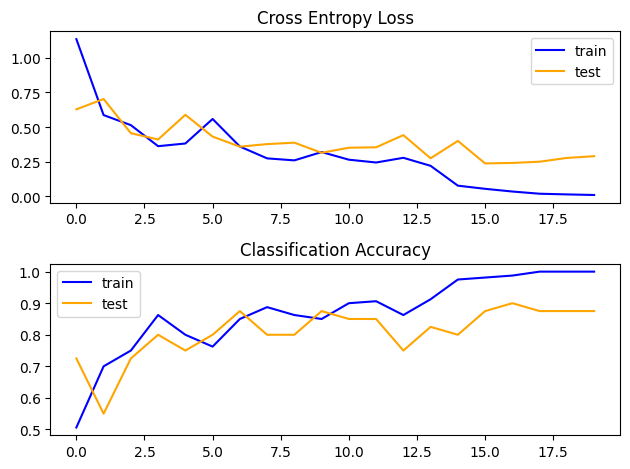

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


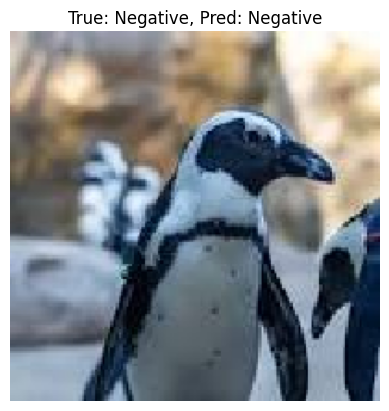

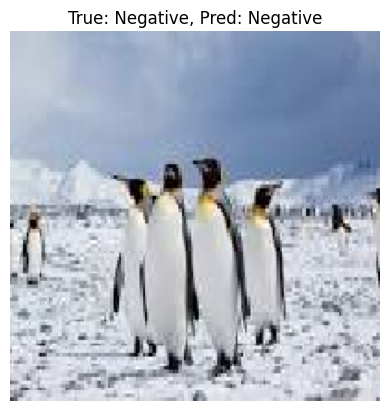

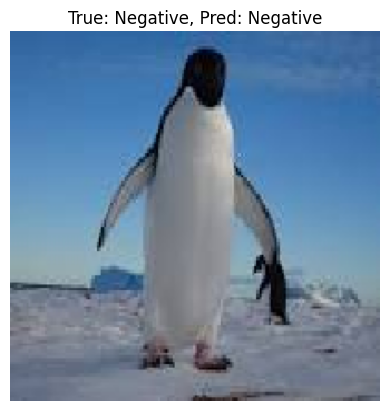

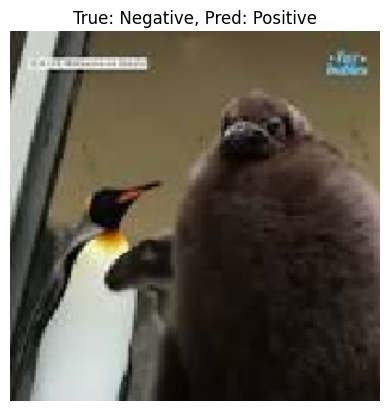

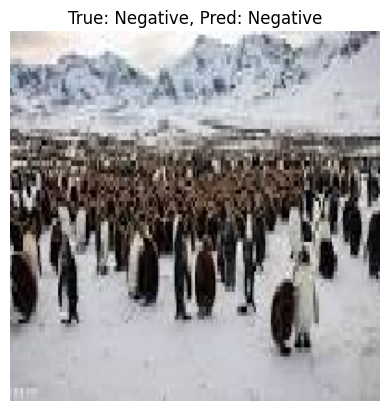

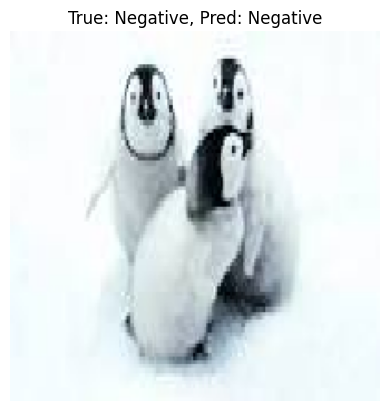

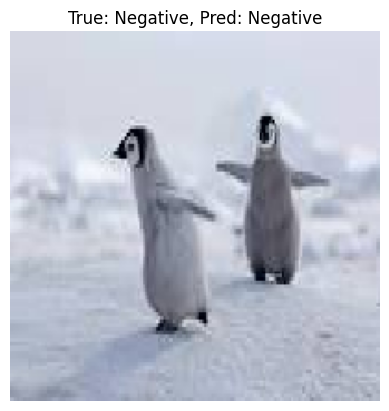

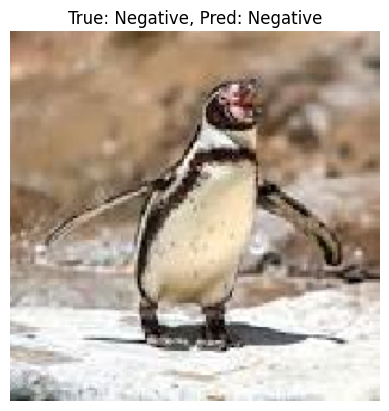

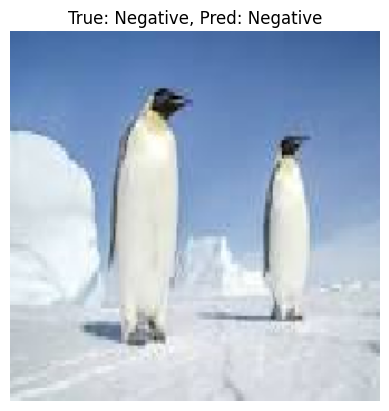

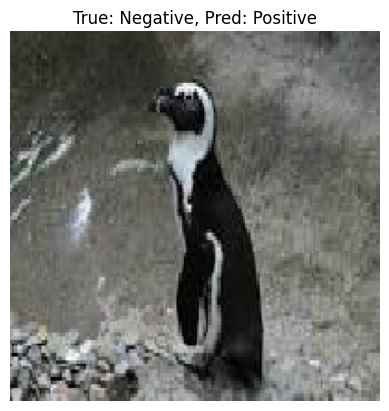

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


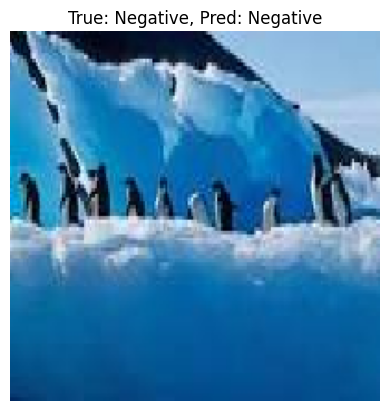

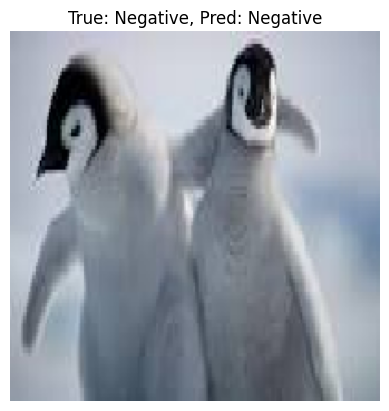

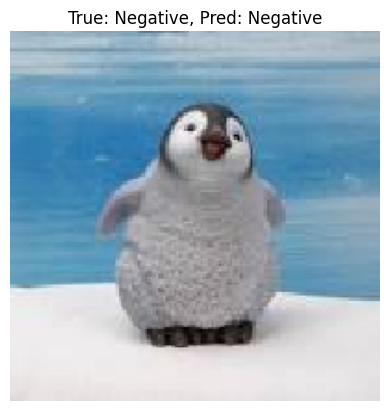

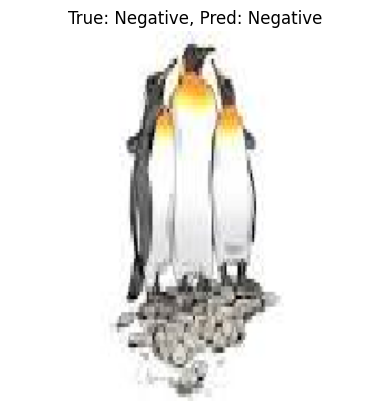

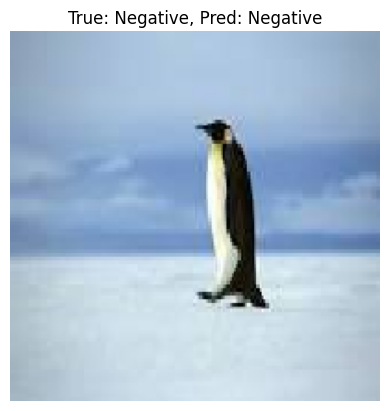

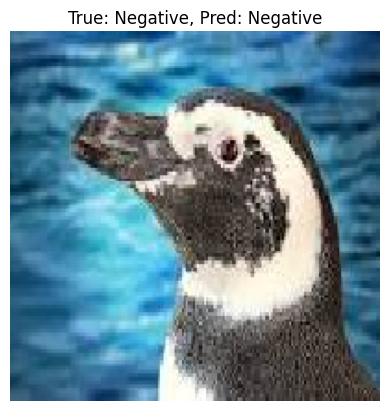

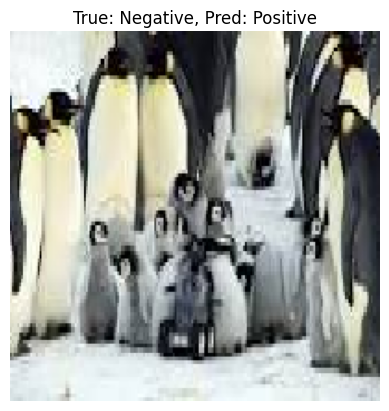

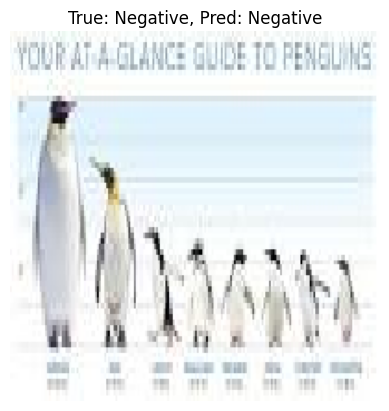

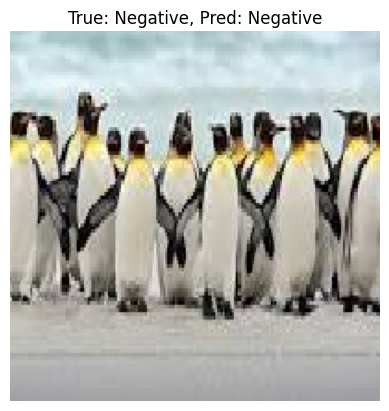

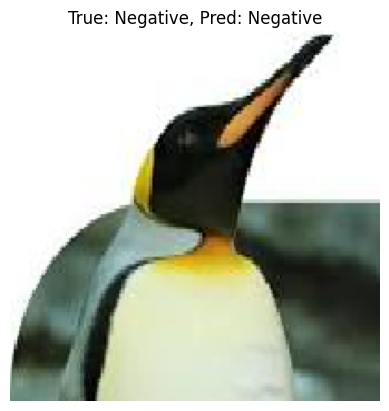

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


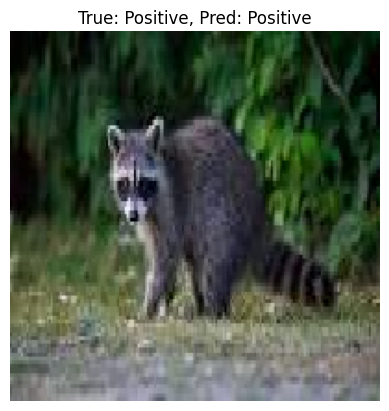

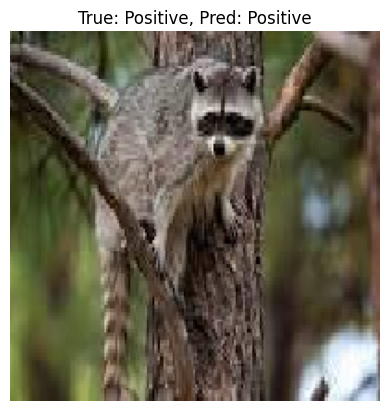

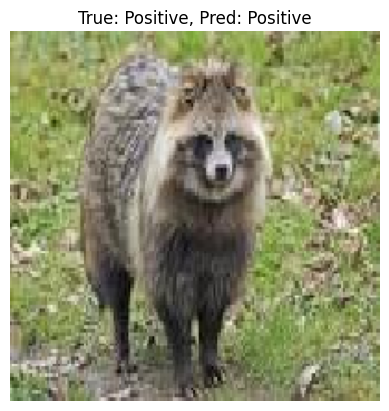

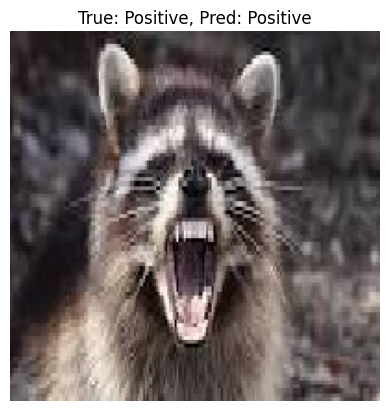

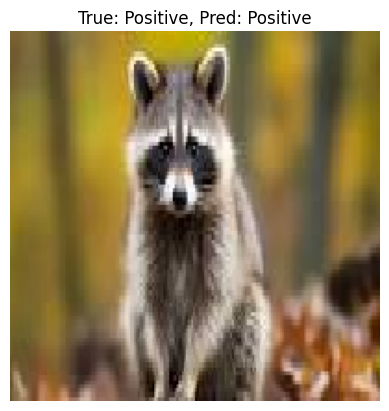

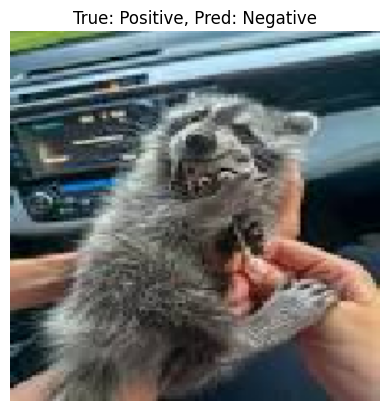

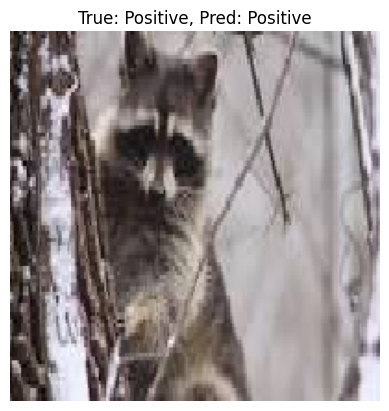

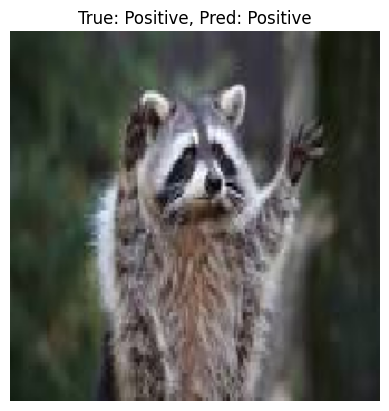

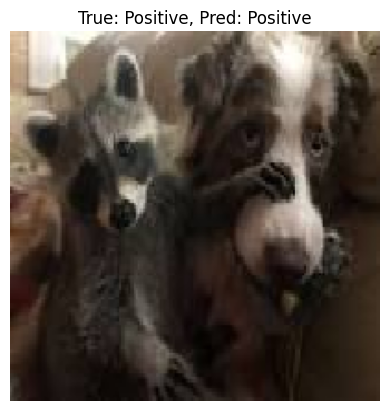

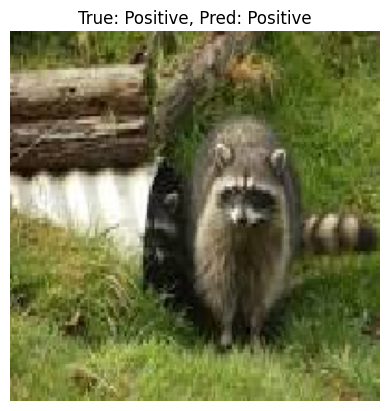

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


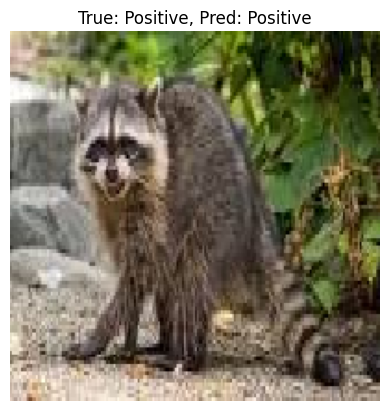

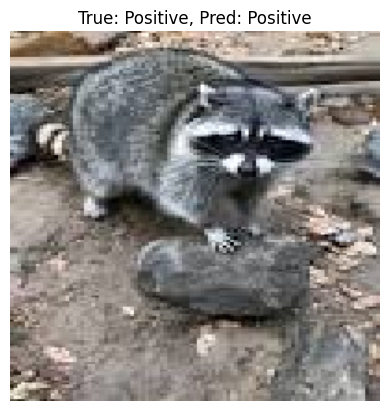

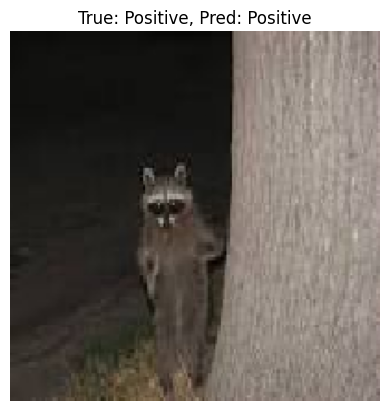

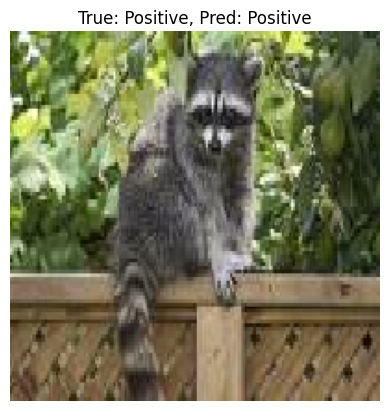

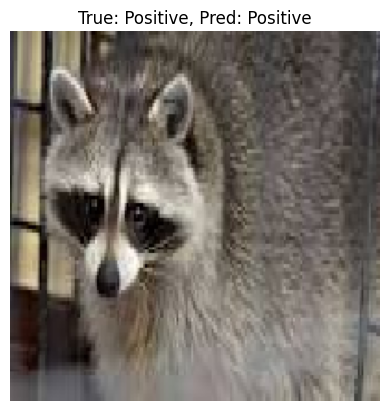

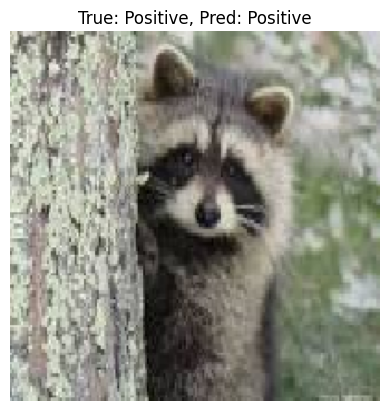

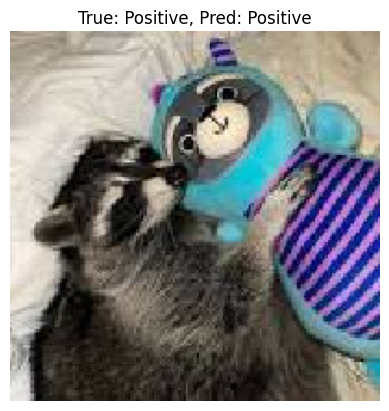

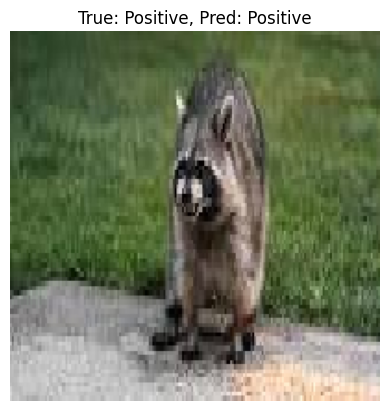

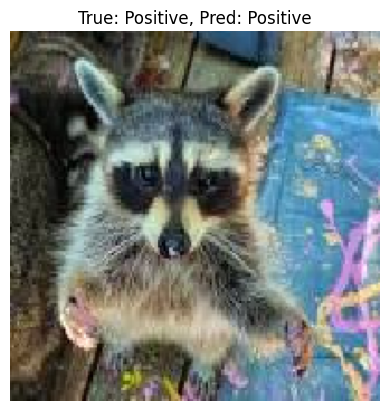

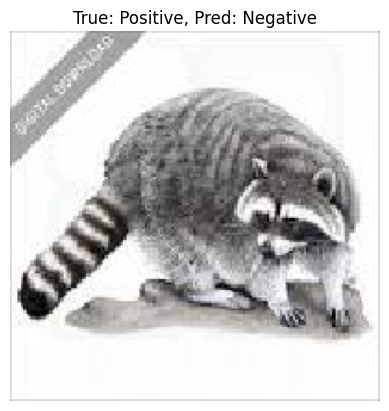

In [7]:


# Define VGG-like model with 3 blocks
def VGG3():
    model = Sequential()

    # Input layer to define input shape
    model.add(Input(shape=(200, 200, 3)))

    # Block 1
    model.add(Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same'))
    model.add(Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same'))
    model.add(MaxPooling2D((2, 2)))

    # Block 2
    model.add(Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same'))
    model.add(Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same'))
    model.add(MaxPooling2D((2, 2)))

    # Block 3
    model.add(Conv2D(256, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same'))
    model.add(Conv2D(256, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same'))
    model.add(MaxPooling2D((2, 2)))

    # Flatten and fully connected layers
    model.add(Flatten())
    model.add(Dense(512, activation='relu', kernel_initializer='he_uniform'))
    model.add(Dense(1, activation='sigmoid'))

    # Compile the model
    opt = SGD(learning_rate=0.001, momentum=0.9)
    model.compile(optimizer=opt, loss='binary_crossentropy', metrics=['accuracy'])

    return model

# Plot diagnostic learning curves
def summarize_diagnostics(history):
    # Plot loss
    pyplot.subplot(211)
    pyplot.title('Cross Entropy Loss')
    pyplot.plot(history.history['loss'], color='blue', label='train')
    pyplot.plot(history.history['val_loss'], color='orange', label='test')
    pyplot.legend()

    # Plot accuracy
    pyplot.subplot(212)
    pyplot.title('Classification Accuracy')
    pyplot.plot(history.history['accuracy'], color='blue', label='train')
    pyplot.plot(history.history['val_accuracy'], color='orange', label='test')
    pyplot.legend()

    # Show the plots
    pyplot.tight_layout()
    pyplot.show()

# Display predictions for test images
def show_predictions(model, test_iterator):
    test_iterator.reset()
    for i in range(len(test_iterator)):
        images, labels = next(test_iterator)
        predictions = model.predict(images)
        for j in range(len(images)):
            pyplot.imshow(images[j])
            true_label = 'Positive' if labels[j] == 1 else 'Negative'
            predicted_label = 'Positive' if predictions[j] > 0.5 else 'Negative'
            pyplot.title(f"True: {true_label}, Pred: {predicted_label}")
            pyplot.axis('off')
            pyplot.show()

# Run the test harness
def run_test_harness():
    # Define model
    model = VGG3()

    # Create data generator
    datagen = ImageDataGenerator(rescale=1.0 / 255.0)

    # Prepare iterators
    train_it = datagen.flow_from_directory('/content/Dataset/Dataset/train',
                                           class_mode='binary', batch_size=10, target_size=(200, 200))
    test_it = datagen.flow_from_directory('/content/Dataset/Dataset/test',
                                          class_mode='binary', batch_size=10, target_size=(200, 200),
                                          shuffle=False)

    # Fit model
    start_time = time.time()
    history = model.fit(train_it, validation_data=test_it, epochs=20, verbose=1)
    end_time = time.time()

    # Report timing
    print(f"Training time: {end_time - start_time:.3f} seconds")

    # Evaluate the model
    _, acc = model.evaluate(test_it, steps=len(test_it), verbose=1)
    print(f"Testing accuracy: {acc * 100.0:.3f}%")

    # Print final metrics
    print(f"Training accuracy: {history.history['accuracy'][-1] * 100.0:.3f}%")
    print(f"Training loss: {history.history['loss'][-1]:.3f}")

    # Plot learning curves
    summarize_diagnostics(history)

    # Show predictions on test data
    show_predictions(model, test_it)

# Entry point
run_test_harness()


In [8]:
# create the model
model = VGG3()
# print the summary of the model
model.summary()

Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_14 (Conv2D)                   │ (None, 200, 200, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_15 (Conv2D)                   │ (None, 200, 200, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_7 (MaxPooling2D)       │ (None, 100, 100, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_16 (Conv2D)                   │ (None, 100, 100, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_17 (Conv2D)                   │ (None, 100, 100, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_8 (MaxPooling2D)       │ (None, 50, 50, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_18 (Conv2D)                   │ (None, 50, 50, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_19 (Conv2D)                   │ (None, 50, 50, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_9 (MaxPooling2D)       │ (None, 25, 25, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_3 (Flatten)                  │ (None, 160000)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_6 (Dense)                      │ (None, 512)                 │      81,920,512 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_7 (Dense)                      │ (None, 1)                   │             513 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 83,066,433 (316.87 MB)

 Trainable params: 83,066,433 (316.87 MB)

 Non-trainable params: 0 (0.00 B)

**VGG (3 BLOCK) WITH DATA AUGMENTATION**

Found 160 images belonging to 2 classes.
Found 40 images belonging to 2 classes.
Epoch 1/20


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


16/16 ━━━━━━━━━━━━━━━━━━━━ 4s 136ms/step - accuracy: 0.4558 - loss: 3.1778 - val_accuracy: 0.5000 - val_loss: 0.6999
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 4s 107ms/step - accuracy: 0.5312 - loss: 0.6880 - val_accuracy: 0.5000 - val_loss: 0.6668
Epoch 3/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 3s 109ms/step - accuracy: 0.5483 - loss: 0.6287 - val_accuracy: 0.7000 - val_loss: 0.6220
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 2s 110ms/step - accuracy: 0.7683 - loss: 0.5510 - val_accuracy: 0.7750 - val_loss: 0.4743
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 2s 107ms/step - accuracy: 0.7864 - loss: 0.4477 - val_accuracy: 0.5500 - val_loss: 0.7690
Epoch 6/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 2s 107ms/step - accuracy: 0.7271 - loss: 0.5915 - val_accuracy: 0.7750 - val_loss: 0.4814
Epoch 7/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 3s 109ms/step - accuracy: 0.7721 - loss: 0.4595 - val_accuracy: 0.7750 - val_loss: 0.4655
Epoch 8/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 0.7890 - loss: 0.3847 - val_accuracy: 0.6750 - val_

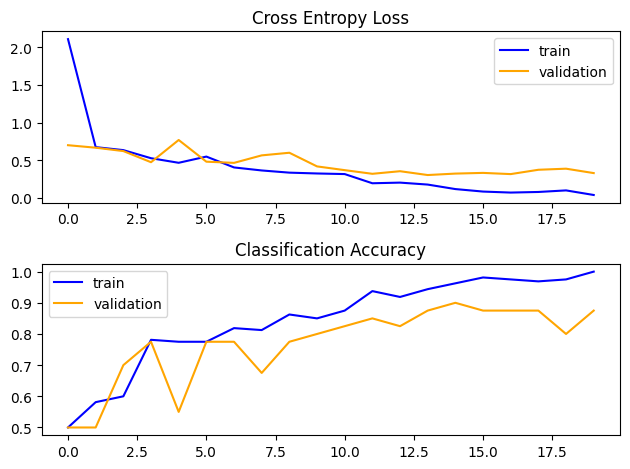

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


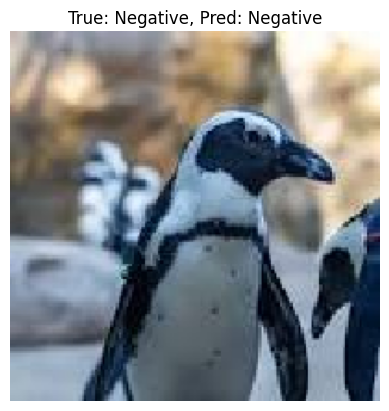

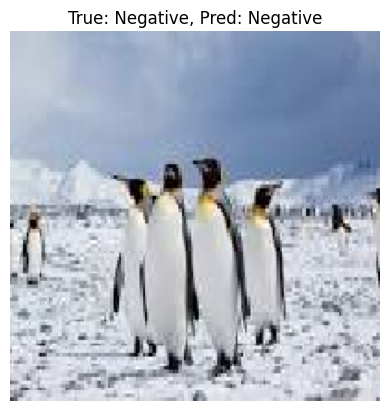

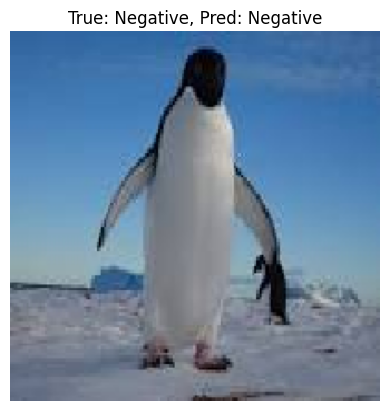

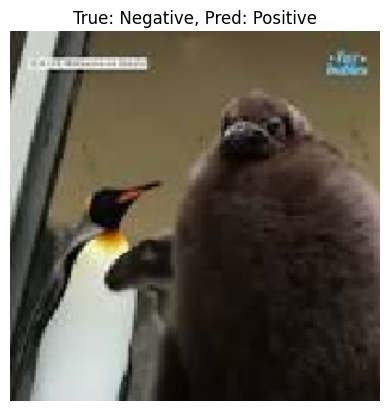

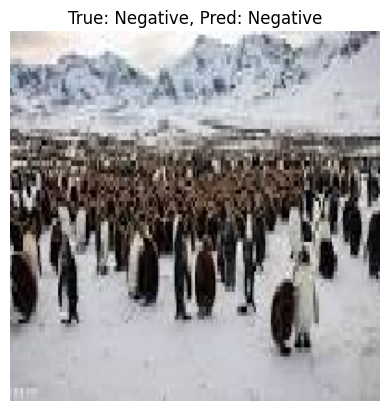

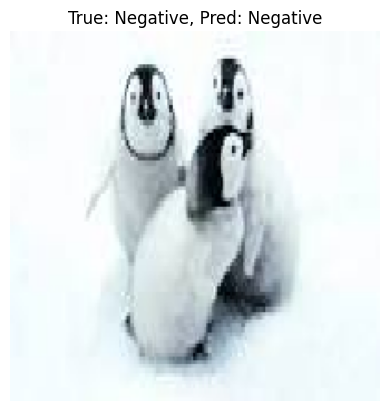

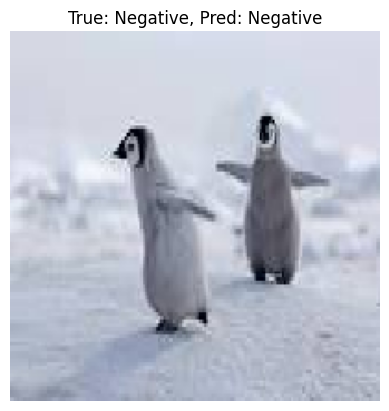

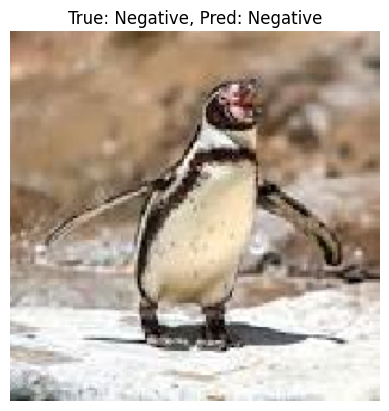

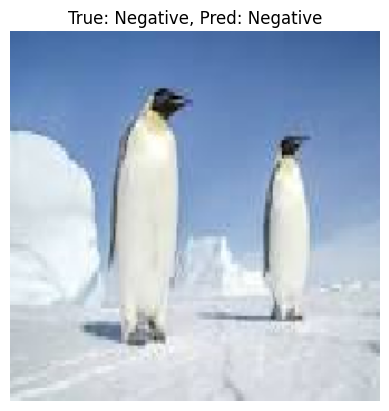

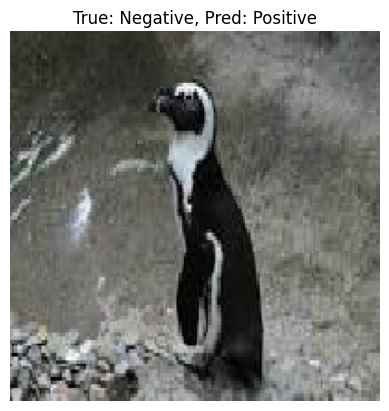

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


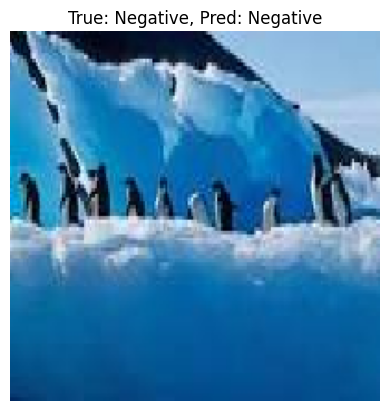

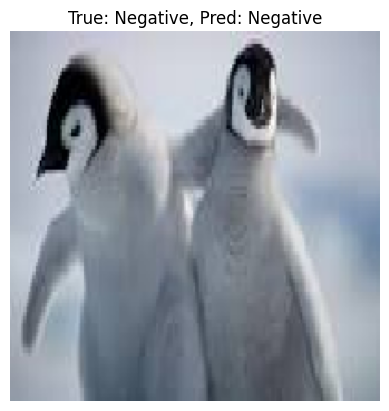

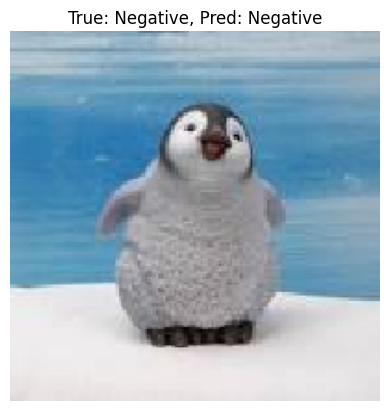

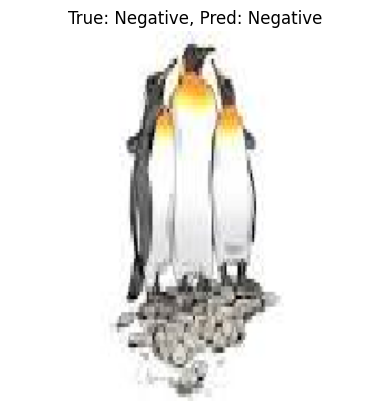

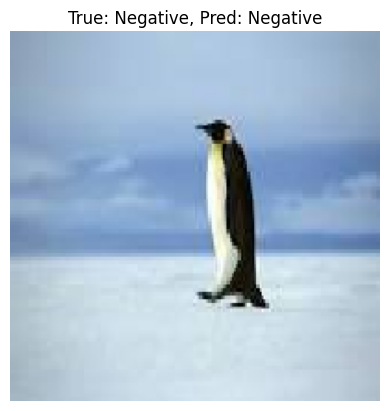

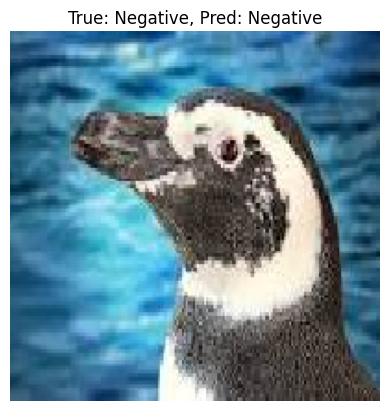

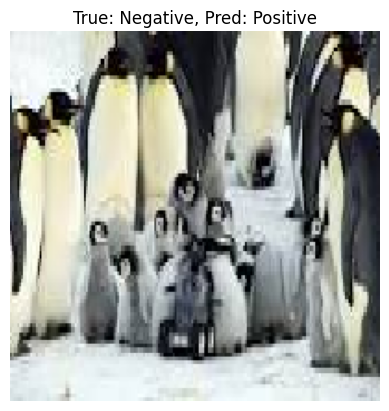

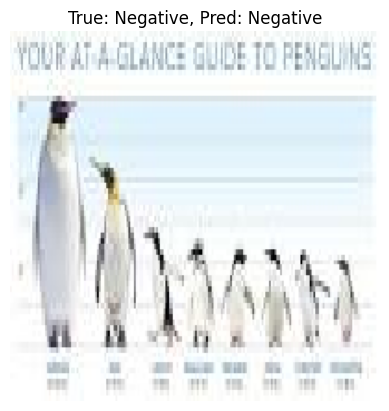

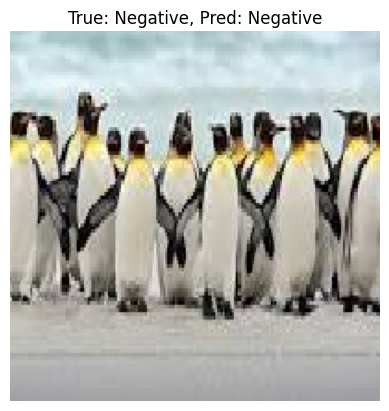

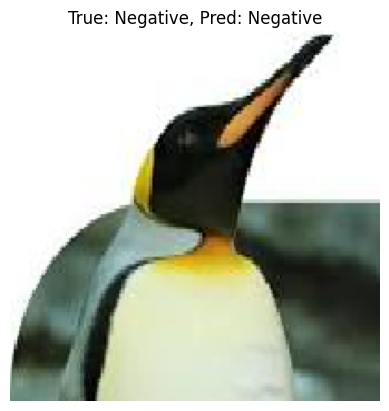

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


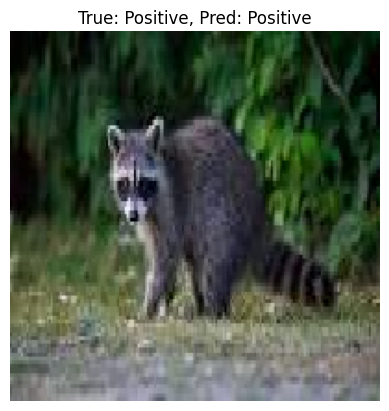

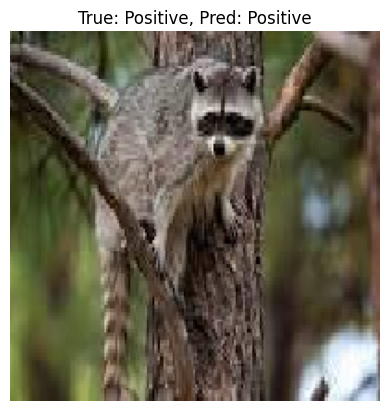

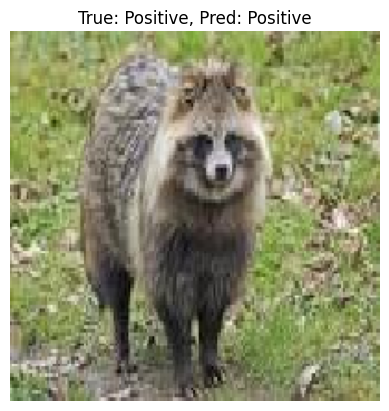

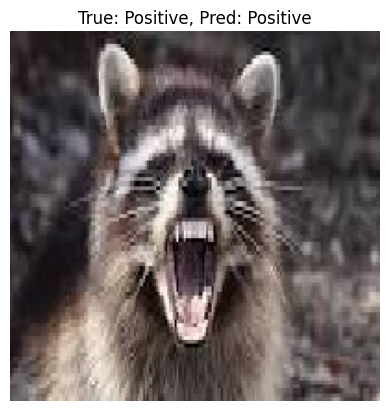

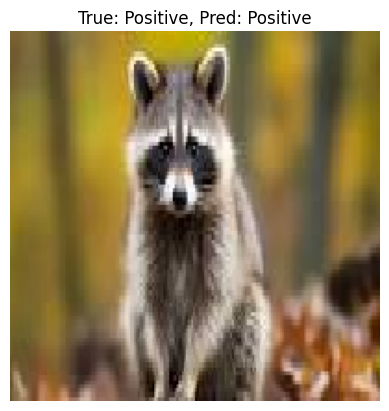

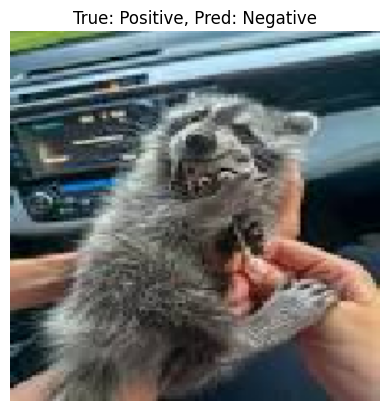

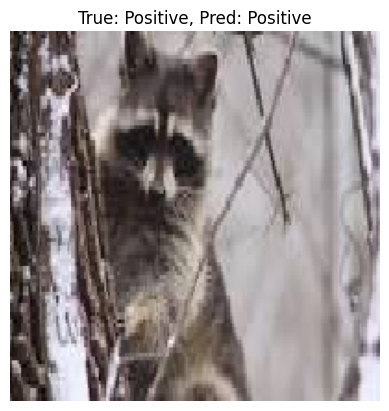

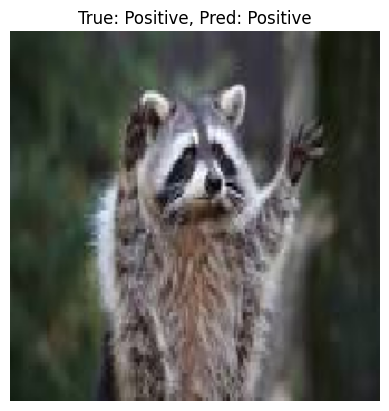

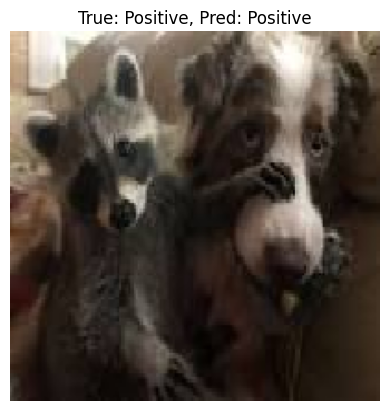

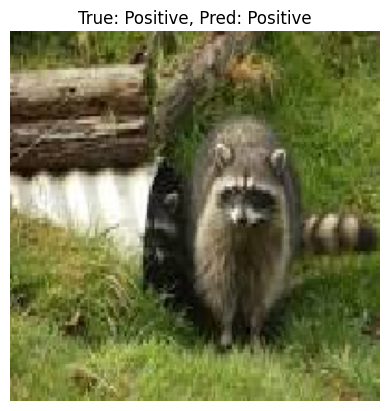

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


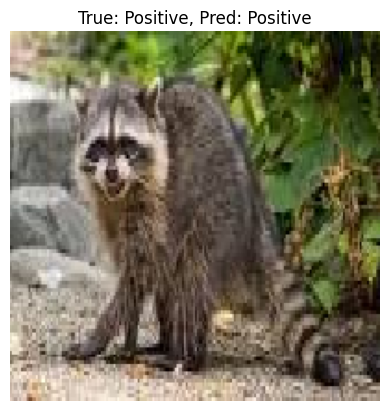

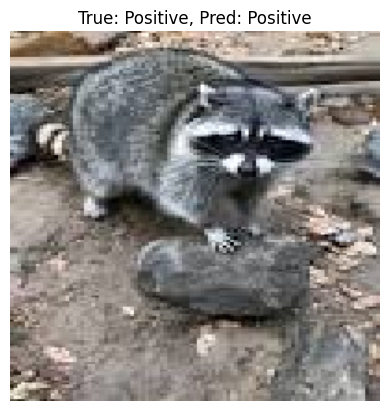

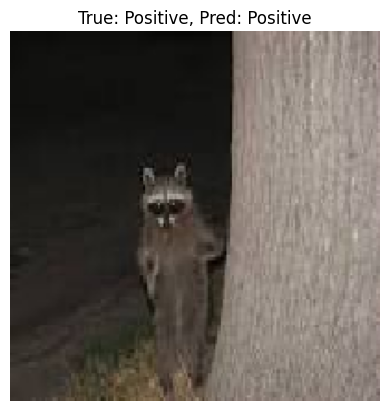

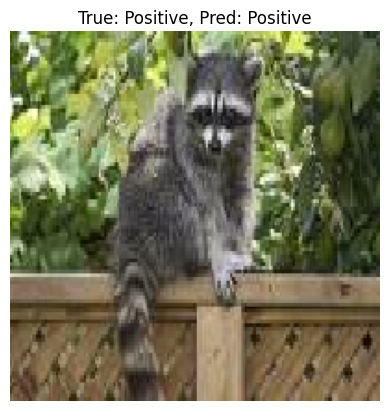

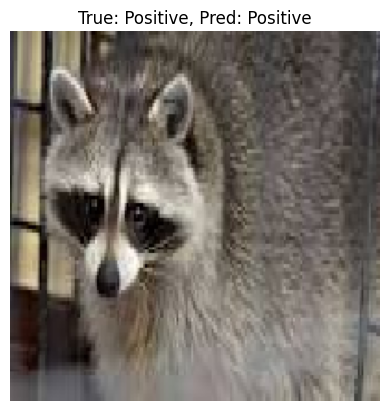

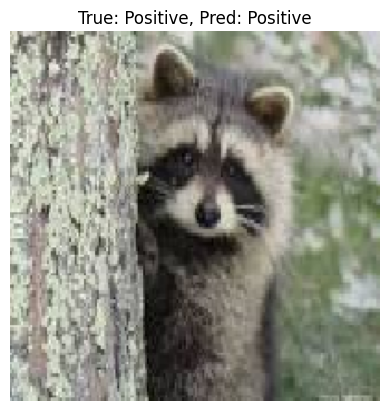

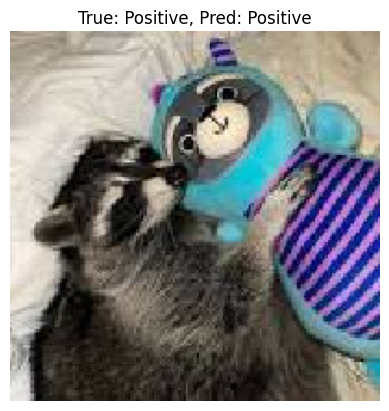

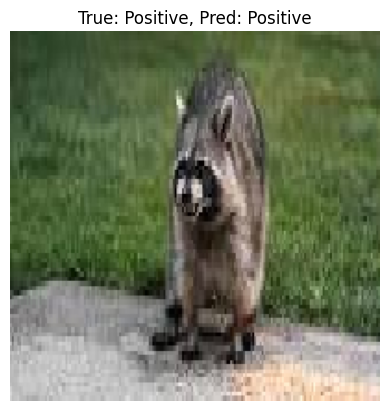

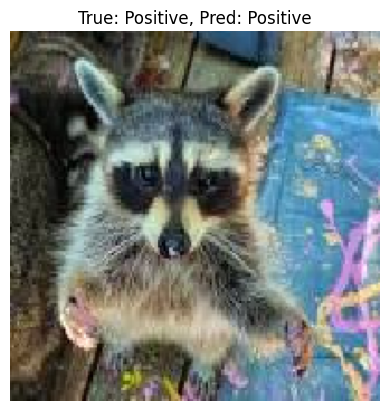

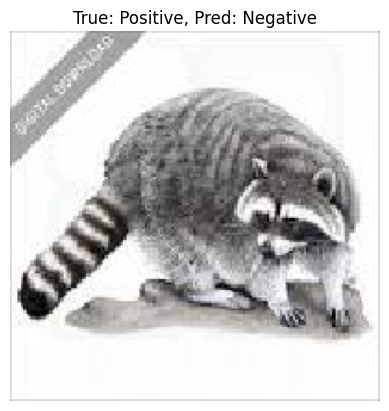

In [9]:
import time
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Input
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from matplotlib import pyplot as plt

# Define VGG-like model
def define_vgg_model():
    model = Sequential()

    # Input layer to define input shape
    model.add(Input(shape=(200, 200, 3)))  # Define input shape here

    # Block 1 - Two convolutional layers followed by max-pooling
    model.add(Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same'))
    model.add(Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same'))
    model.add(MaxPooling2D((2, 2)))  # Max pooling after the convolutional layers

    # Block 2 - Two convolutional layers followed by max-pooling
    model.add(Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same'))
    model.add(Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same'))
    model.add(MaxPooling2D((2, 2)))  # Max pooling after the convolutional layers

    # Block 3 - Two convolutional layers followed by max-pooling
    model.add(Conv2D(256, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same'))
    model.add(Conv2D(256, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same'))
    model.add(MaxPooling2D((2, 2)))  # Max pooling after the convolutional layers

    # Flatten the output before feeding to fully connected layers
    model.add(Flatten())

    # Fully connected layers (dense layers)
    model.add(Dense(512, activation='relu', kernel_initializer='he_uniform'))
    model.add(Dense(1, activation='sigmoid'))  # Output layer for binary classification

    # Compile the model
    opt = SGD(learning_rate=0.001, momentum=0.9)
    model.compile(optimizer=opt, loss='binary_crossentropy', metrics=['accuracy'])

    return model

# Define data augmentation
def define_data_augmentation():
    datagen = ImageDataGenerator(
        rotation_range=20,       # Random rotations
        width_shift_range=0.2,   # Random horizontal shifts
        height_shift_range=0.2,  # Random vertical shifts
        shear_range=0.2,         # Random shearing
        zoom_range=0.2,          # Random zoom
        horizontal_flip=True,    # Random horizontal flip
        fill_mode='nearest'      # Filling mode for new pixels after transformation
    )
    return datagen

# Plot learning curves
def summarize_diagnostics(history):
    # Plot loss
    plt.subplot(211)
    plt.title('Cross Entropy Loss')
    plt.plot(history.history['loss'], color='blue', label='train')
    plt.plot(history.history['val_loss'], color='orange', label='validation')
    plt.legend()

    # Plot accuracy
    plt.subplot(212)
    plt.title('Classification Accuracy')
    plt.plot(history.history['accuracy'], color='blue', label='train')
    plt.plot(history.history['val_accuracy'], color='orange', label='validation')
    plt.legend()

    plt.tight_layout()
    plt.show()

# Run the test harness
def run_test_harness():
    # Example setup, use your own data
    train_data_dir = 'path_to_train_data'
    validation_data_dir = 'path_to_validation_data'

    # Define model
    model = define_vgg_model()

    # Create data generator
    datagen = ImageDataGenerator(rescale=1.0 / 255.0)

    # Assuming you have already defined the ImageDataGenerators for loading data
    train_it = datagen.flow_from_directory('/content/Dataset/Dataset/train',
                                           class_mode='binary', batch_size=10, target_size=(200, 200))
    test_it = datagen.flow_from_directory('/content/Dataset/Dataset/test',
                                          class_mode='binary', batch_size=10, target_size=(200, 200),
                                          shuffle=False)

    # Train the model
    start_time = time.time()

    # Fit the model
    history = model.fit(train_it, validation_data=test_it, epochs=20, verbose=1)

    # End training timer
    end_time = time.time()

    # Report training time
    print(f"Training time: {end_time - start_time:.3f} seconds")

    # Evaluate the model on the test set
    _, acc = model.evaluate(test_it, steps=len(test_it), verbose=1)
    print(f"Testing accuracy: {acc * 100.0:.3f}%")

    # Print final metrics
    print(f"Training accuracy: {history.history['accuracy'][-1] * 100.0:.3f}%")
    print(f"Training loss: {history.history['loss'][-1]:.3f}")

    # Plot learning curves
    summarize_diagnostics(history)

    # Show predictions on test data
    show_predictions(model, test_it)

# Entry point
run_test_harness()



In [10]:
# create the model
model = define_vgg_model()
# print the summary of the model
model.summary()

Model: "sequential_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_26 (Conv2D)                   │ (None, 200, 200, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_27 (Conv2D)                   │ (None, 200, 200, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_13 (MaxPooling2D)      │ (None, 100, 100, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_28 (Conv2D)                   │ (None, 100, 100, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_29 (Conv2D)                   │ (None, 100, 100, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_14 (MaxPooling2D)      │ (None, 50, 50, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_30 (Conv2D)                   │ (None, 50, 50, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_31 (Conv2D)                   │ (None, 50, 50, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_15 (MaxPooling2D)      │ (None, 25, 25, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_5 (Flatten)                  │ (None, 160000)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_10 (Dense)                     │ (None, 512)                 │      81,920,512 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_11 (Dense)                     │ (None, 1)                   │             513 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 83,066,433 (316.87 MB)

 Trainable params: 83,066,433 (316.87 MB)

 Non-trainable params: 0 (0.00 B)

**VGG16 FINE-TUNE ALL LAYERS**


58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Found 160 images belonging to 2 classes.
Found 40 images belonging to 2 classes.
Epoch 1/20


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


16/16 ━━━━━━━━━━━━━━━━━━━━ 12s 309ms/step - accuracy: 0.6968 - loss: 0.5767 - val_accuracy: 0.8750 - val_loss: 0.2357
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 3s 183ms/step - accuracy: 0.9234 - loss: 0.1744 - val_accuracy: 0.9250 - val_loss: 0.2137
Epoch 3/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 3s 176ms/step - accuracy: 0.9905 - loss: 0.0422 - val_accuracy: 0.8750 - val_loss: 0.3550
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 3s 177ms/step - accuracy: 0.9942 - loss: 0.0363 - val_accuracy: 0.9250 - val_loss: 0.1952
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 3s 179ms/step - accuracy: 0.9662 - loss: 0.0571 - val_accuracy: 0.9250 - val_loss: 0.1982
Epoch 6/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 3s 181ms/step - accuracy: 1.0000 - loss: 0.0288 - val_accuracy: 0.9500 - val_loss: 0.2160
Epoch 7/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 3s 181ms/step - accuracy: 1.0000 - loss: 0.0028 - val_accuracy: 0.8750 - val_loss: 0.4991
Epoch 8/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 5s 181ms/step - accuracy: 1.0000 - loss: 4.2314e-04 - val_accuracy: 0.8750 -

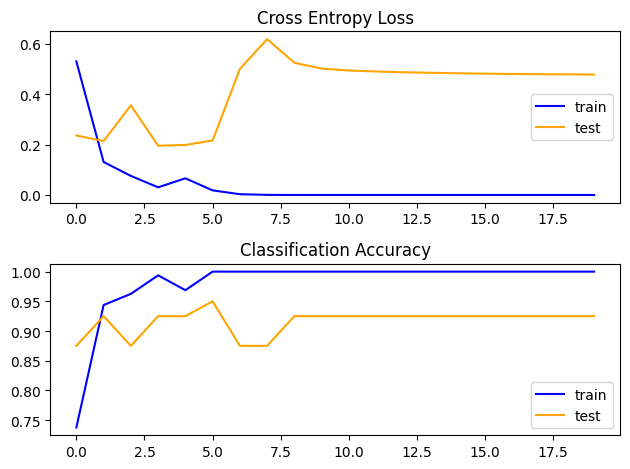

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 438ms/step


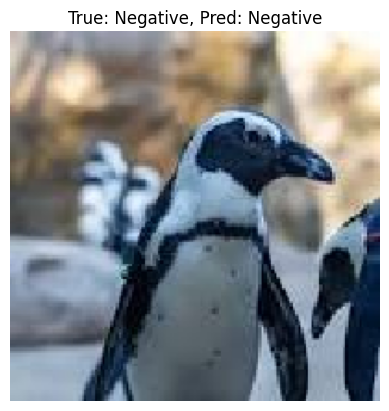

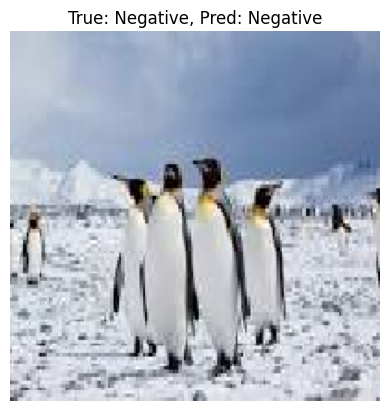

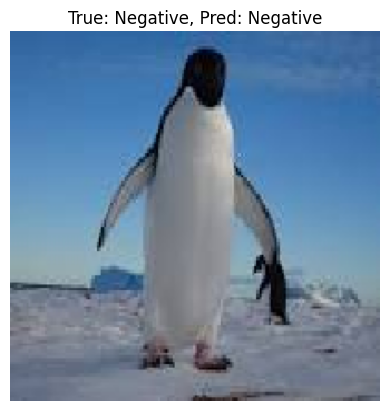

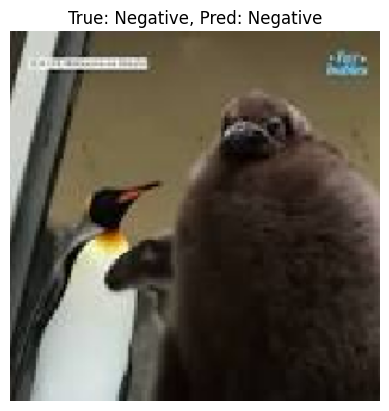

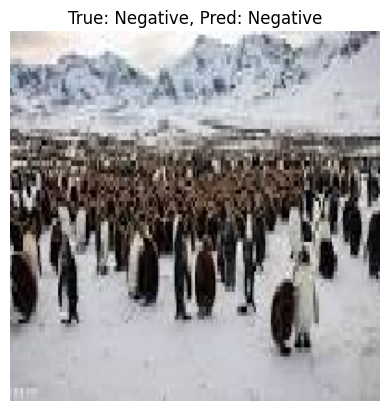

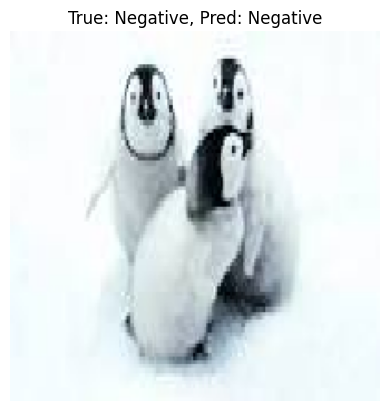

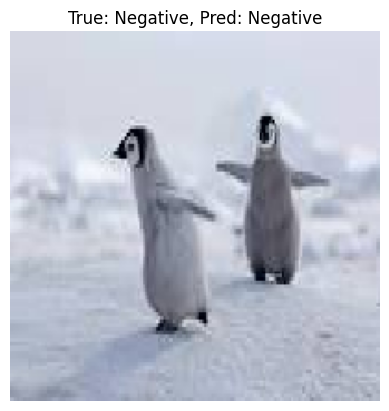

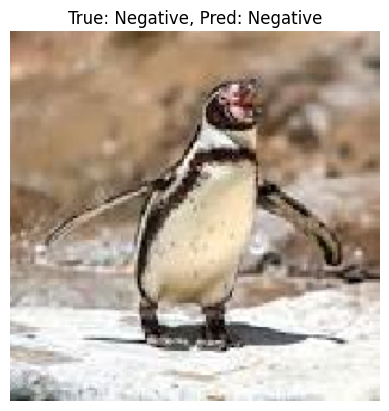

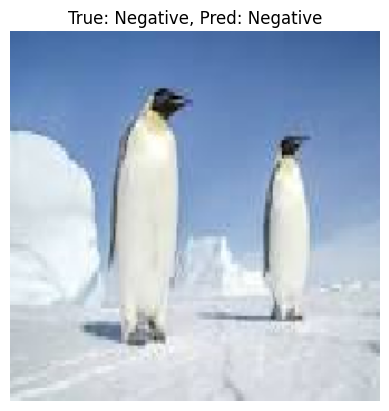

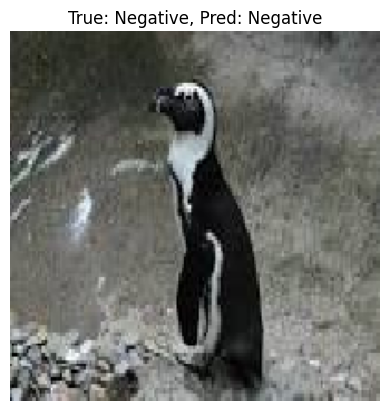

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


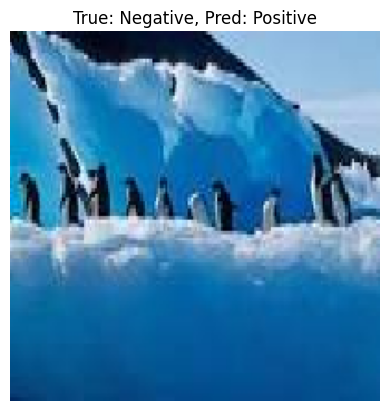

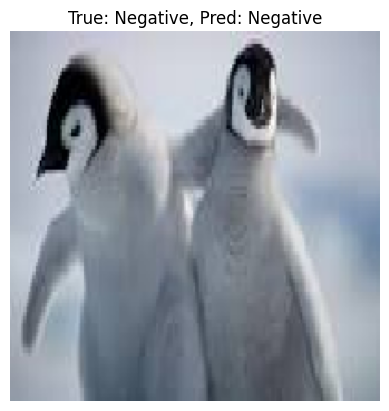

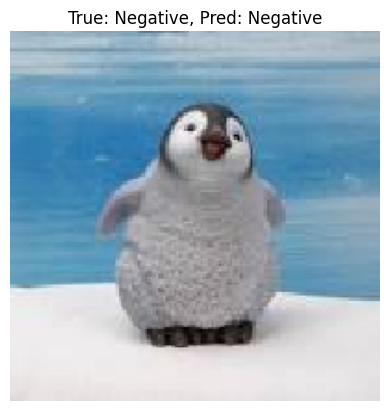

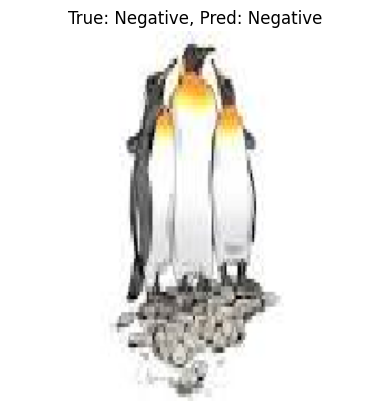

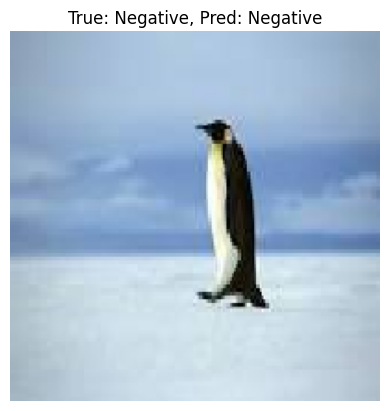

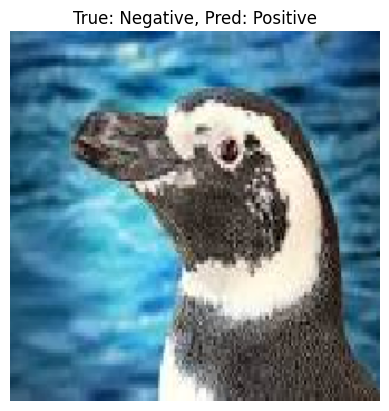

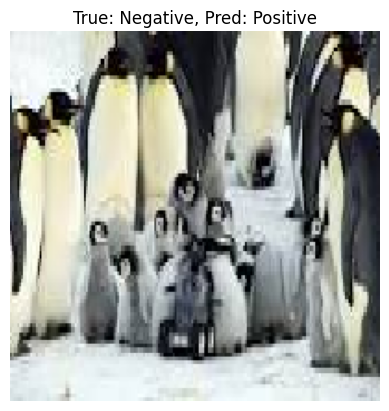

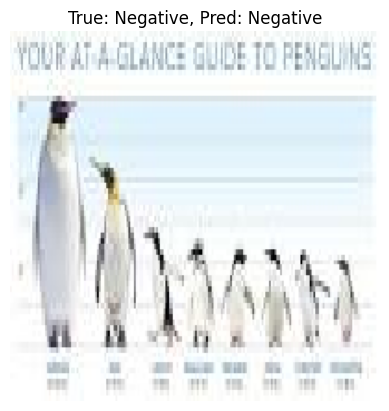

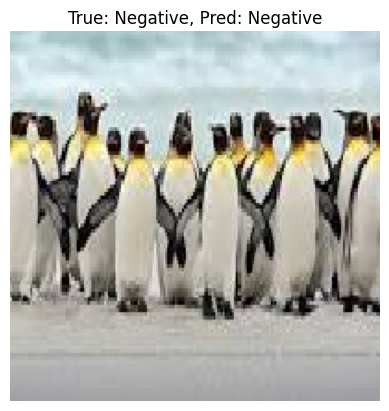

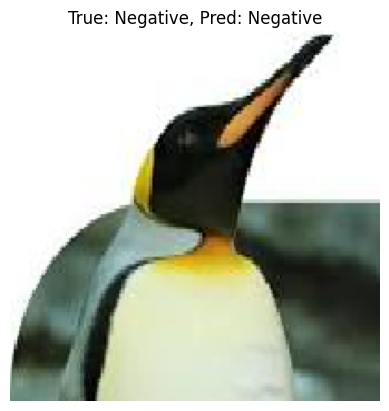

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


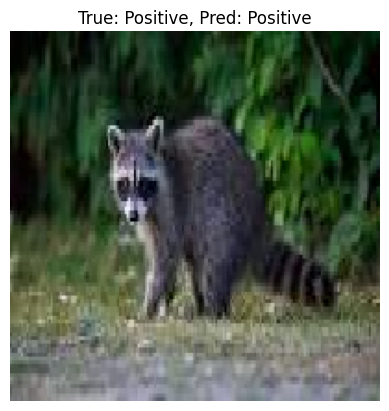

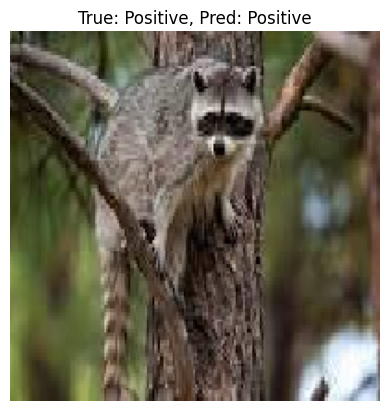

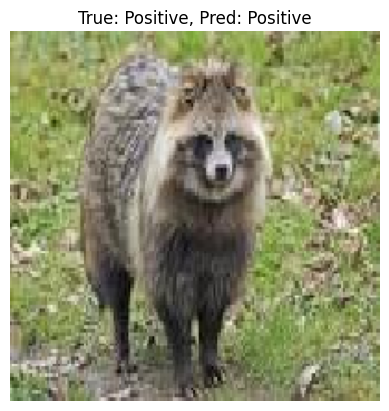

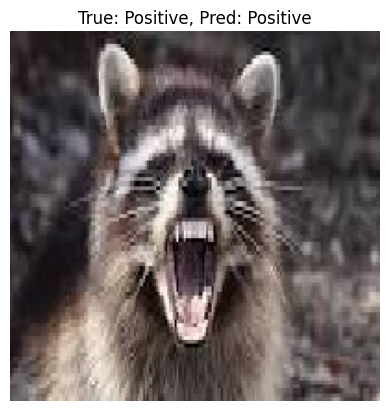

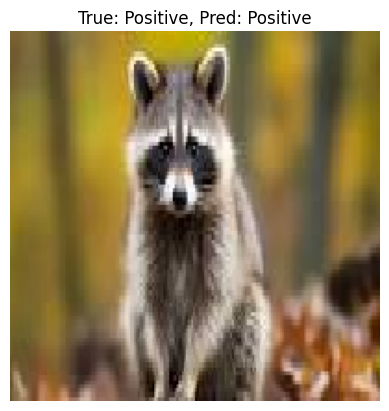

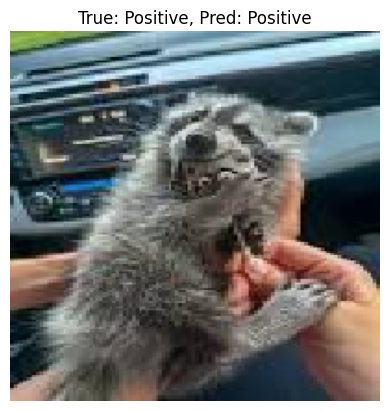

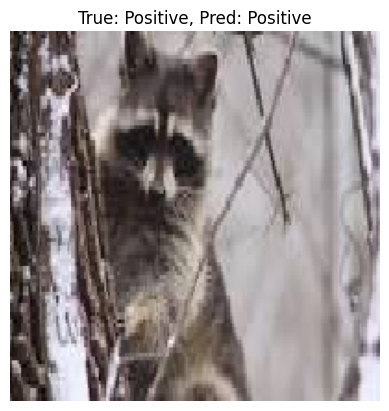

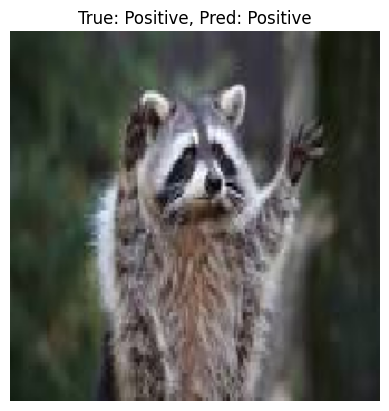

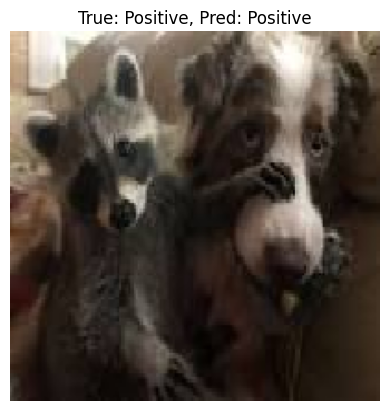

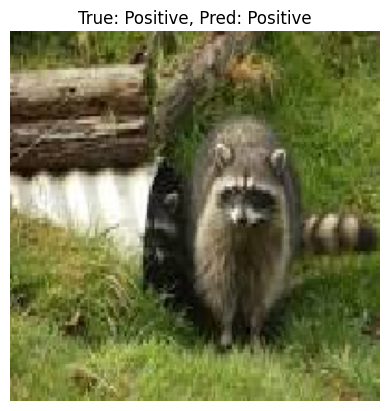

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


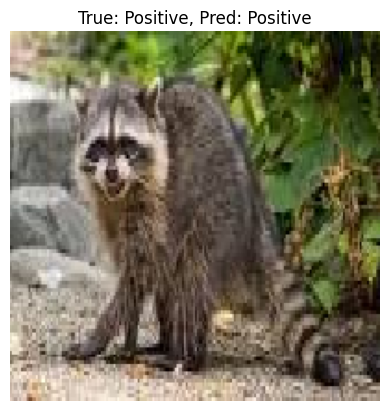

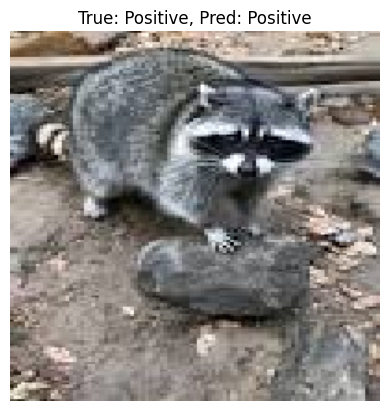

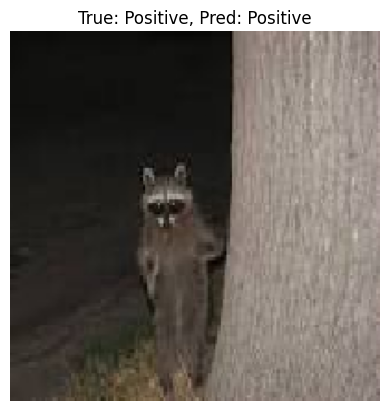

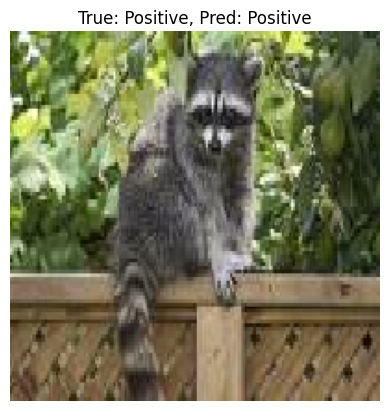

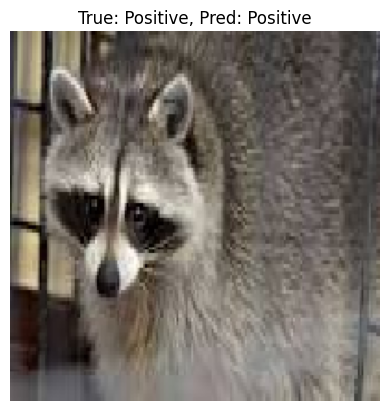

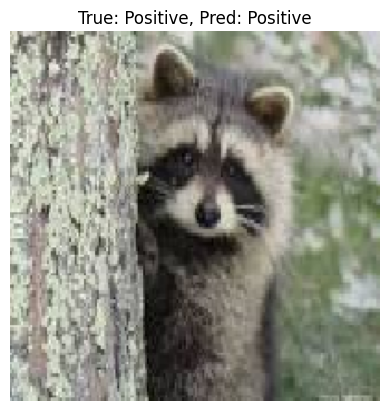

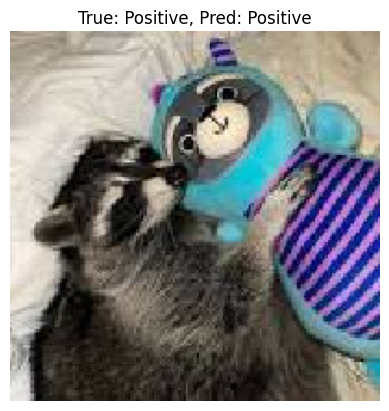

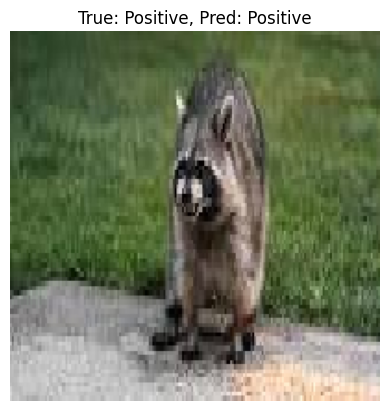

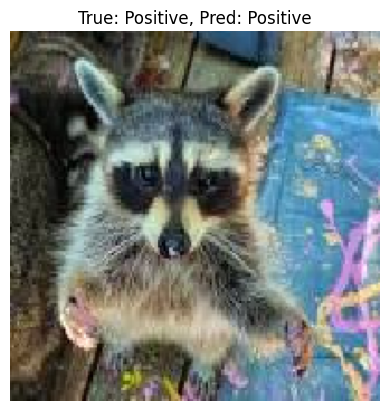

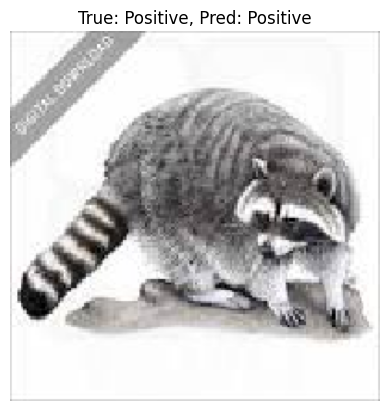

In [11]:

from keras.applications.vgg16 import VGG16
from keras.models import Model


# Define the VGG16-based model
def VGG_FINE_TUNE():
    # Load the VGG16 model without the top fully connected layers
    model = VGG16(include_top=False, weights='imagenet', input_shape=(200, 200, 3))

    # Fine-tune all layers
    for layer in model.layers:
        layer.trainable = True

    # Add custom classifier layers
    flat1 = Flatten()(model.layers[-1].output)
    class1 = Dense(128, activation='relu', kernel_initializer='he_uniform')(flat1)
    output = Dense(1, activation='sigmoid')(class1)  # Binary classification

    # Define new model
    model = Model(inputs=model.inputs, outputs=output)

    # Compile the model
    opt = SGD(learning_rate=0.001, momentum=0.9)
    model.compile(optimizer=opt, loss='binary_crossentropy', metrics=['accuracy'])

    return model

# Plot diagnostic learning curves
def summarize_diagnostics(history):
    # Plot loss
    pyplot.subplot(211)
    pyplot.title('Cross Entropy Loss')
    pyplot.plot(history.history['loss'], color='blue', label='train')
    pyplot.plot(history.history['val_loss'], color='orange', label='test')
    pyplot.legend()

    # Plot accuracy
    pyplot.subplot(212)
    pyplot.title('Classification Accuracy')
    pyplot.plot(history.history['accuracy'], color='blue', label='train')
    pyplot.plot(history.history['val_accuracy'], color='orange', label='test')
    pyplot.legend()

    # Show the plots
    pyplot.tight_layout()
    pyplot.show()

# Display predictions for test images
def show_predictions(model, test_iterator):
    test_iterator.reset()
    for i in range(len(test_iterator)):
        images, labels = next(test_iterator)
        predictions = model.predict(images)
        for j in range(len(images)):
            pyplot.imshow(images[j])
            true_label = 'Positive' if labels[j] == 1 else 'Negative'
            predicted_label = 'Positive' if predictions[j] > 0.5 else 'Negative'
            pyplot.title(f"True: {true_label}, Pred: {predicted_label}")
            pyplot.axis('off')
            pyplot.show()

# Run the test harness
def run_test_harness():
    # Define the model
    model = VGG_FINE_TUNE()

    # Create data generator
    datagen = ImageDataGenerator(rescale=1.0 / 255.0)

    # Prepare iterators
    train_it = datagen.flow_from_directory('/content/Dataset/Dataset/train',
                                           class_mode='binary', batch_size=10, target_size=(200, 200))
    test_it = datagen.flow_from_directory('/content/Dataset/Dataset/test',
                                          class_mode='binary', batch_size=10, target_size=(200, 200),
                                          shuffle=False)

    # Start training timer
    start_time = time.time()

    # Fit the model
    history = model.fit(train_it, validation_data=test_it, epochs=20, verbose=1)

    # End training timer
    end_time = time.time()

    # Report training time
    print(f"Training time: {end_time - start_time:.3f} seconds")

    # Evaluate the model on the test set
    _, acc = model.evaluate(test_it, steps=len(test_it), verbose=1)
    print(f"Testing accuracy: {acc * 100.0:.3f}%")

    # Print final metrics
    print(f"Training accuracy: {history.history['accuracy'][-1] * 100.0:.3f}%")
    print(f"Training loss: {history.history['loss'][-1]:.3f}")

    # Plot learning curves
    summarize_diagnostics(history)

    # Show predictions on test data
    show_predictions(model, test_it)

# Entry point
run_test_harness()


In [13]:
# create the model
model = VGG_FINE_TUNE()
# print the summary of the model
model.summary()

Model: "functional_67"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_7 (InputLayer)           │ (None, 200, 200, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 200, 200, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 200, 200, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 100, 100, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 100, 100, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 100, 100, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 50, 50, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 50, 50, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 50, 50, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 50, 50, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 25, 25, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 25, 25, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 25, 25, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 25, 25, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 12, 12, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 12, 12, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 12, 12, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 12, 12, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 6, 6, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_7 (Flatten)                  │ (None, 18432)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_14 (Dense)                     │ (None, 128)                 │       2,359,424 │
├──────────────────────────────────────┼─────────────────────────────┼──────────────

 Total params: 17,074,241 (65.13 MB)

 Trainable params: 17,074,241 (65.13 MB)

 Non-trainable params: 0 (0.00 B)

1. Are the results as expected? Why or why not?
Expected Outcome for VGG (1 BLOCK): The model should have a lower accuracy compared to more complex architectures with more blocks. With just one block, the model may struggle to learn complex features.
Expected Outcome for VGG (3 BLOCKS): Adding more blocks to the architecture should improve performance, as the model has more capacity to learn and capture increasingly complex features.
Expected Outcome for VGG ( 3 BLOCKS ) with data augumentation: The addition of data augmentation should help in improving model generalization by providing more varied input data. This might improve performance by reducing overfitting.
2. Does it matter how many epochs you fine-tune the model?
Fine-tuning for too few epochs may result in underfitting, where the model has not fully learned the features of the new dataset. Conversely, too many epochs may cause overfitting, where the model becomes overly specialized to the training data and loses its ability to generalize.
3. Are there any particular images that the model is confused about?
Yes
Due to Bad Lighting, Similar Images, Inadequate Data Augmentation etc.


**VGG16 WITH TUNING ONLY MLP**


Found 160 images belonging to 2 classes.
Found 40 images belonging to 2 classes.
Epoch 1/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 3s 110ms/step - accuracy: 0.4593 - loss: 0.6729 - val_accuracy: 0.9000 - val_loss: 0.3552
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 75ms/step - accuracy: 0.8913 - loss: 0.3072 - val_accuracy: 0.9250 - val_loss: 0.2493
Epoch 3/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 70ms/step - accuracy: 0.9704 - loss: 0.1265 - val_accuracy: 0.9000 - val_loss: 0.2146
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 68ms/step - accuracy: 0.9912 - loss: 0.0874 - val_accuracy: 0.9500 - val_loss: 0.2450
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 61ms/step - accuracy: 0.9595 - loss: 0.1000 - val_accuracy: 0.9250 - val_loss: 0.2052
Epoch 6/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 70ms/step - accuracy: 0.9985 - loss: 0.0595 - val_accuracy: 0.8750 - val_loss: 0.2253
Epoch 7/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 62ms/step - accuracy: 1.0000 - loss: 0.0322 - val_accuracy: 0.9000 - val_loss: 0.3387
Epoch 8/20
16/16 ━━━━━━━━━━━━

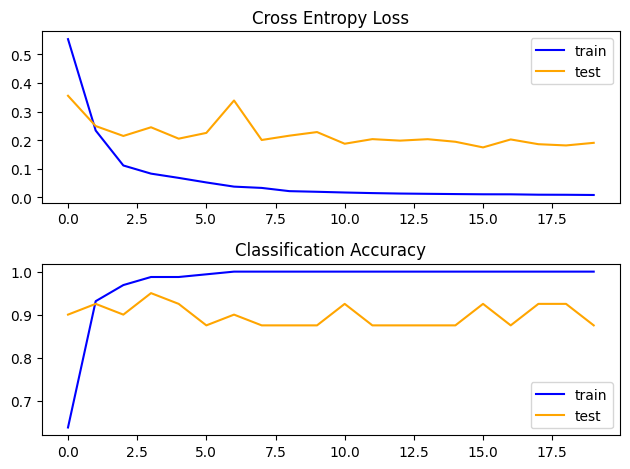

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step


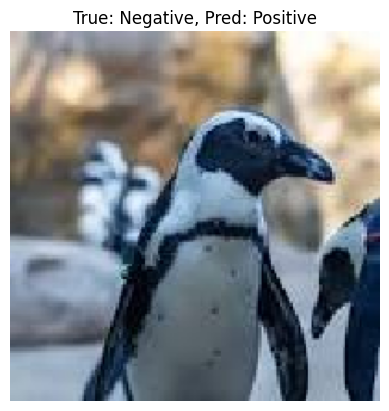

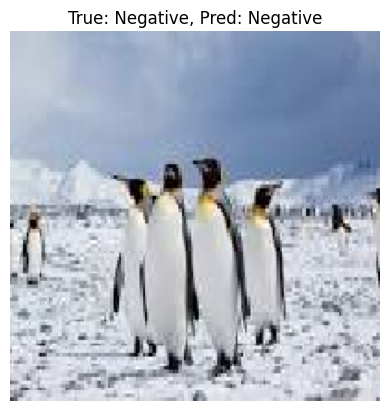

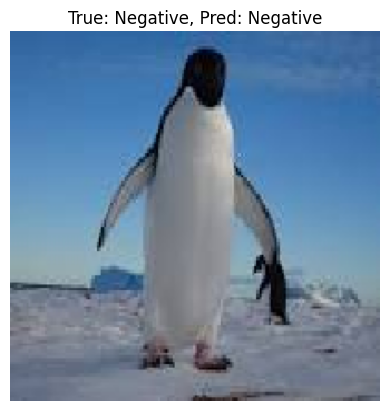

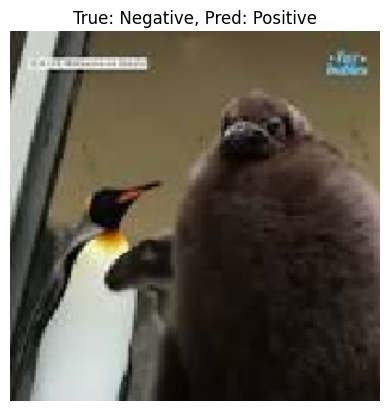

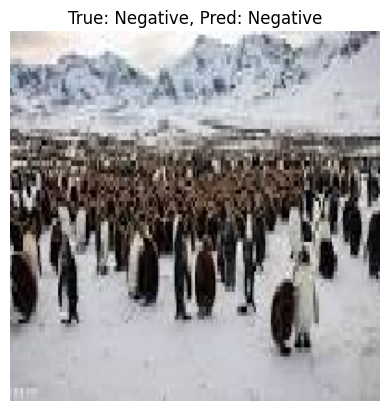

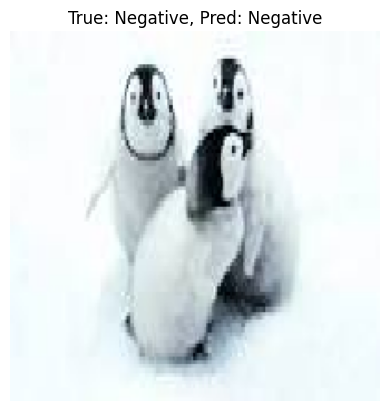

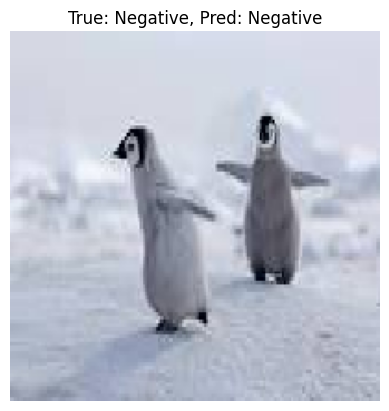

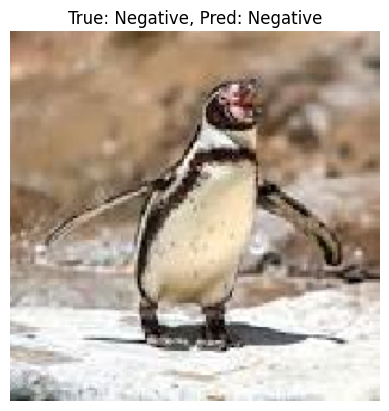

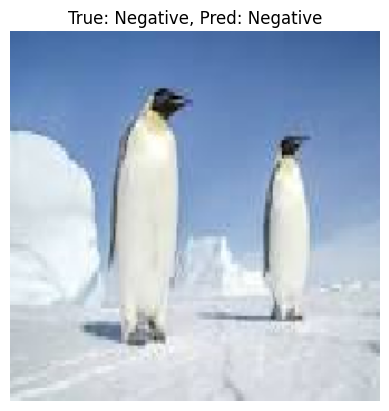

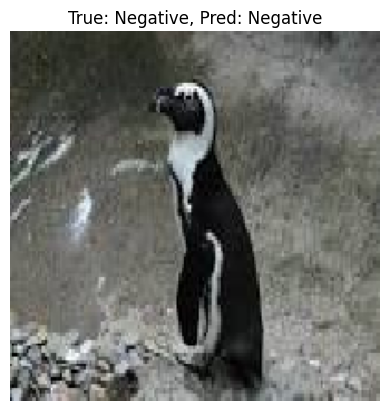

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


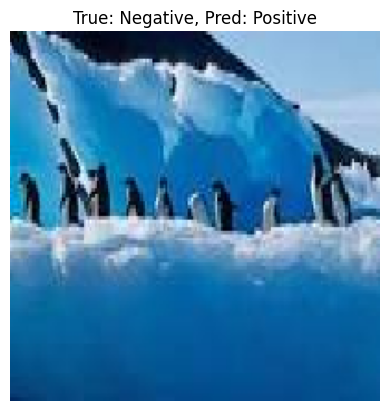

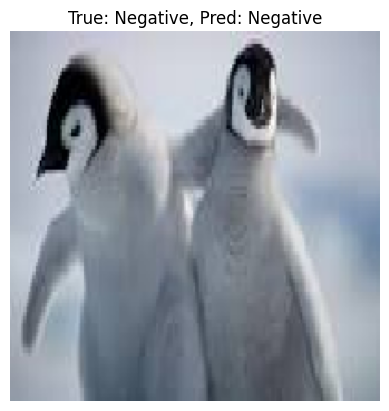

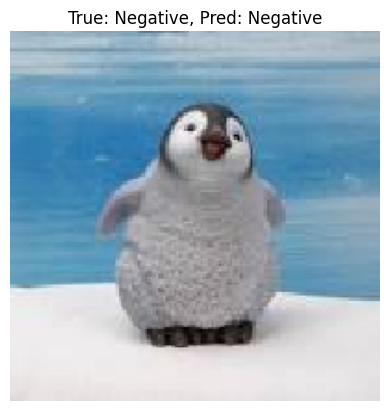

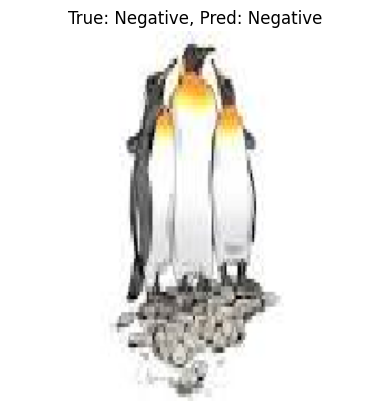

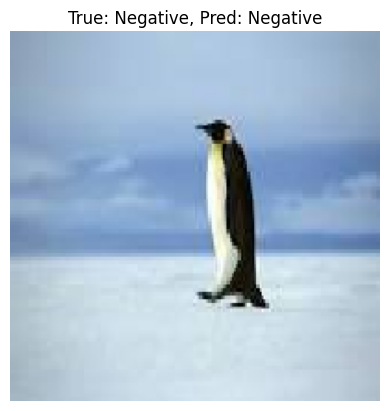

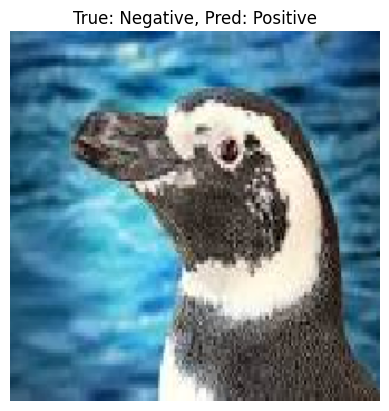

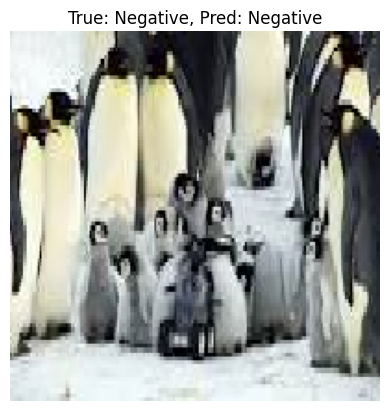

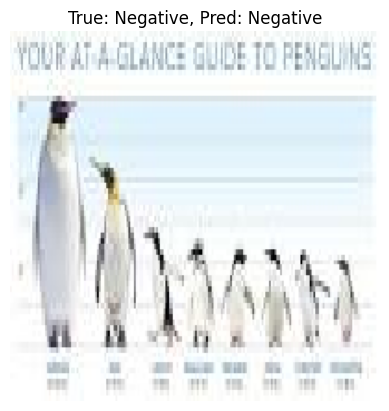

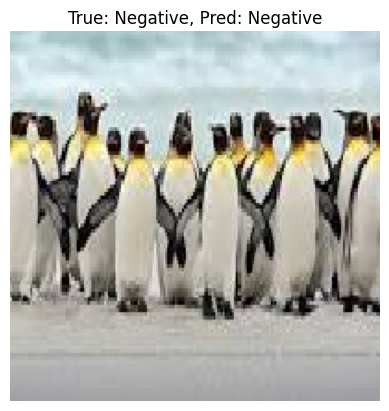

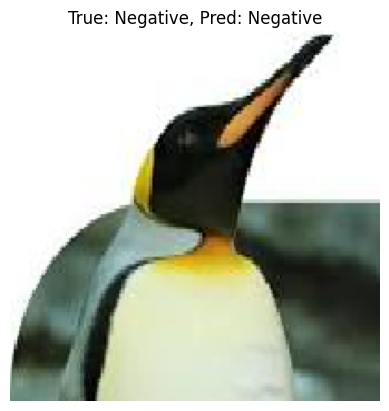

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


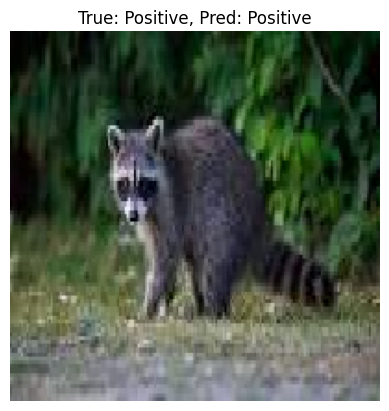

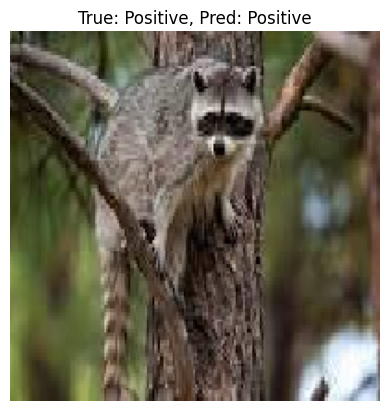

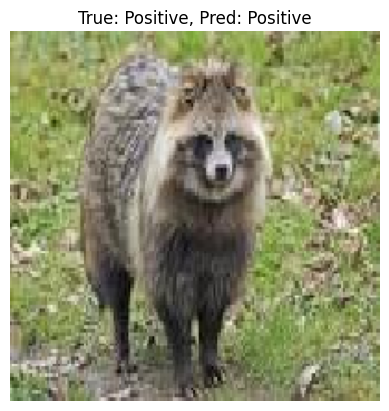

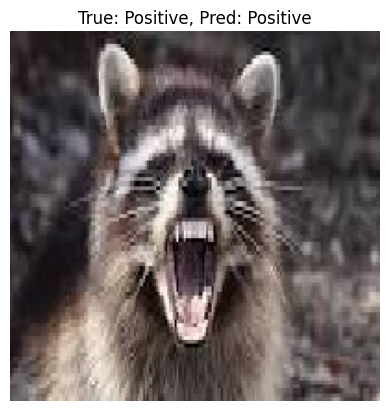

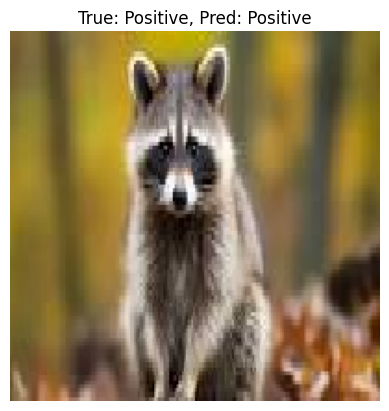

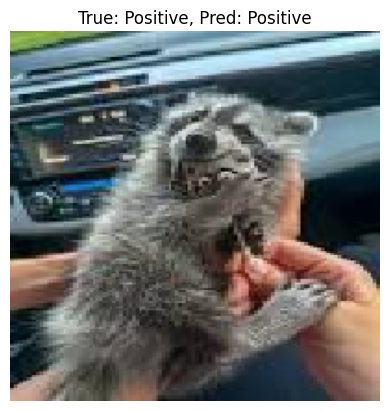

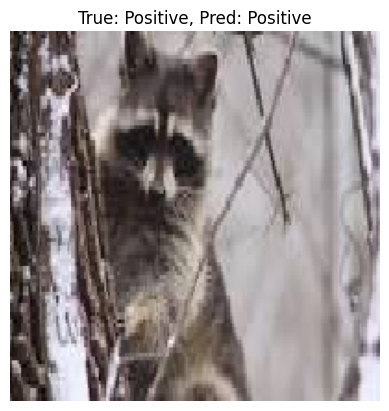

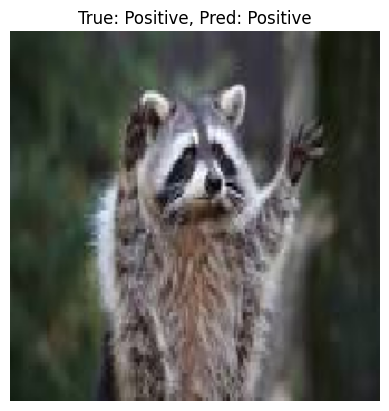

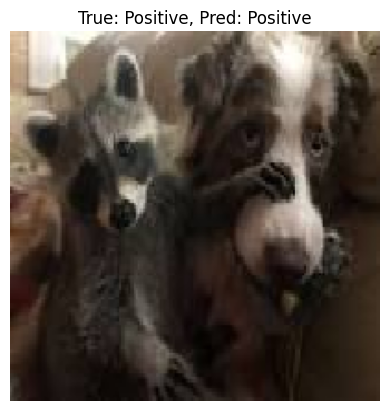

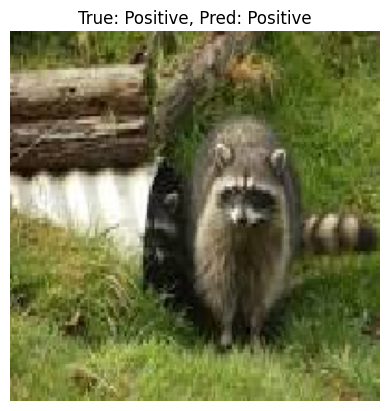

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


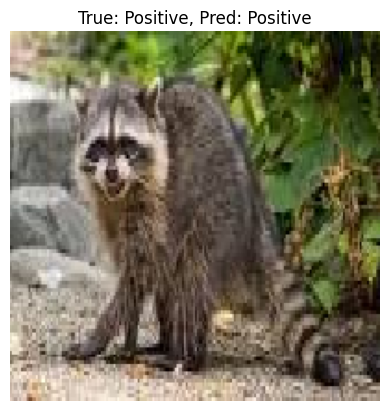

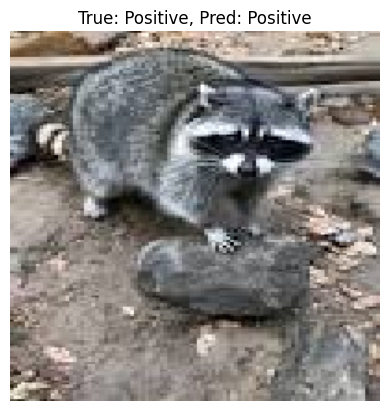

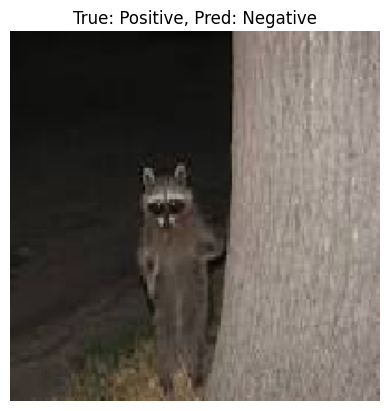

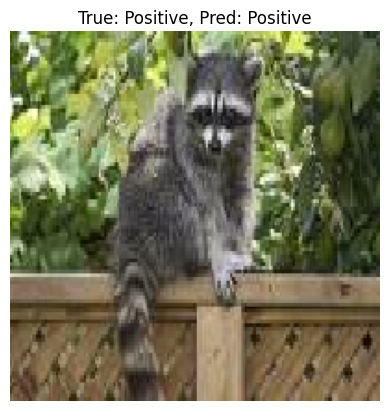

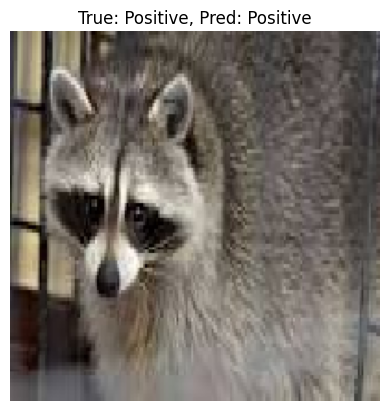

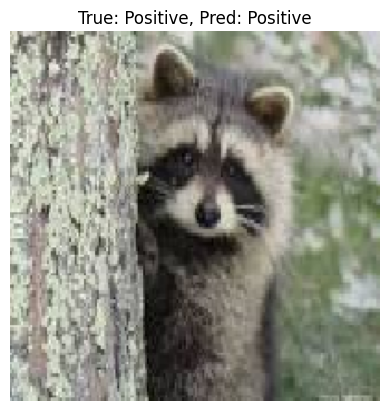

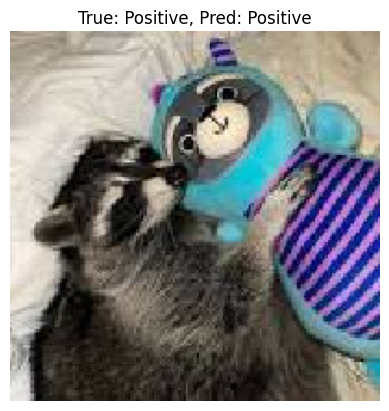

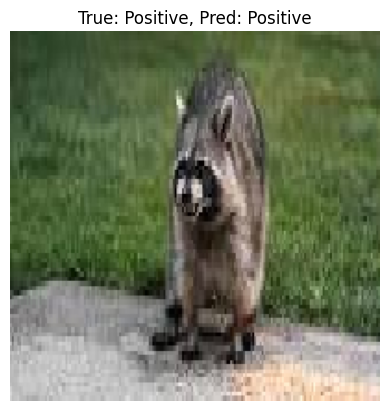

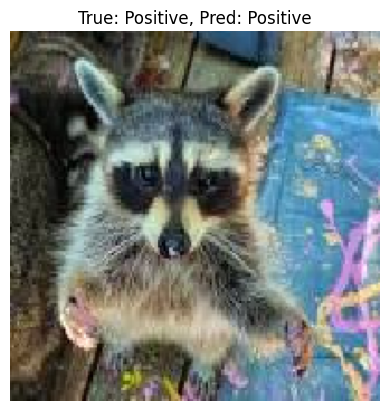

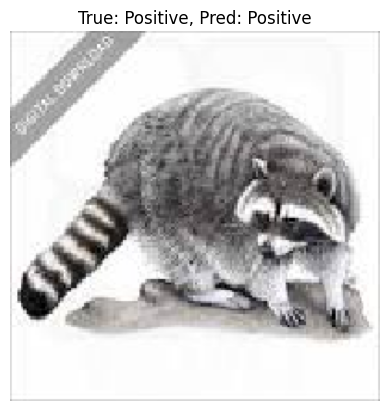

In [ ]:
import time
from matplotlib import pyplot
from keras.applications.vgg16 import VGG16
from keras.models import Model
from keras.layers import Flatten, Dense
from keras.optimizers import SGD
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Define the VGG16 model with frozen convolutional layers
def VGG16_MLP():
    # Load the pre-trained VGG16 model without the top fully connected layers
    model = VGG16(include_top=False, weights='imagenet', input_shape=(200, 200, 3))

    # Freeze all convolutional layers
    for layer in model.layers:
        layer.trainable = False

    # Add new fully connected layers
    flat1 = Flatten()(model.layers[-1].output)
    class1 = Dense(128, activation='relu', kernel_initializer='he_uniform')(flat1)
    output = Dense(1, activation='sigmoid')(class1)  # Binary classification

    # Define the model
    model = Model(inputs=model.inputs, outputs=output)

    # Compile the model
    opt = SGD(learning_rate=0.001, momentum=0.9)
    model.compile(optimizer=opt, loss='binary_crossentropy', metrics=['accuracy'])

    return model

# Plot diagnostic learning curves
def summarize_diagnostics(history):
    # Plot loss
    pyplot.subplot(211)
    pyplot.title('Cross Entropy Loss')
    pyplot.plot(history.history['loss'], color='blue', label='train')
    pyplot.plot(history.history['val_loss'], color='orange', label='test')
    pyplot.legend()

    # Plot accuracy
    pyplot.subplot(212)
    pyplot.title('Classification Accuracy')
    pyplot.plot(history.history['accuracy'], color='blue', label='train')
    pyplot.plot(history.history['val_accuracy'], color='orange', label='test')
    pyplot.legend()

    # Show the plots
    pyplot.tight_layout()
    pyplot.show()

# Display predictions on the test set
def show_predictions(model, test_iterator):
    test_iterator.reset()
    for i in range(len(test_iterator)):
        images, labels = next(test_iterator)
        predictions = model.predict(images)
        for j in range(len(images)):
            pyplot.imshow(images[j])
            true_label = 'Positive' if labels[j] == 1 else 'Negative'
            predicted_label = 'Positive' if predictions[j] > 0.5 else 'Negative'
            pyplot.title(f"True: {true_label}, Pred: {predicted_label}")
            pyplot.axis('off')
            pyplot.show()

# Run the test harness
def run_test_harness():
    # Define the model
    model = VGG16_MLP()

    # Create data generator
    datagen = ImageDataGenerator(rescale=1.0 / 255.0)

    # Prepare data iterators
    train_it = datagen.flow_from_directory('/content/Dataset/Dataset/train',
                                           class_mode='binary', batch_size=10, target_size=(200, 200))
    test_it = datagen.flow_from_directory('/content/Dataset/Dataset/test',
                                          class_mode='binary', batch_size=10, target_size=(200, 200),
                                          shuffle=False)

    # Start training timer
    start_time = time.time()

    # Train the model
    history = model.fit(train_it, validation_data=test_it, epochs=20, verbose=1)

    # End training timer
    end_time = time.time()

    # Report training time
    print(f"Training time: {end_time - start_time:.3f} seconds")

    # Evaluate the model
    _, acc = model.evaluate(test_it, steps=len(test_it), verbose=1)
    print(f"Testing accuracy: {acc * 100.0:.3f}%")

    # Print final metrics
    print(f"Training accuracy: {history.history['accuracy'][-1] * 100.0:.3f}%")
    print(f"Training loss: {history.history['loss'][-1]:.3f}")

    # Plot learning curves
    summarize_diagnostics(history)

    # Display predictions on test data
    show_predictions(model, test_it)

# Entry point
run_test_harness()


In [ ]:
# create the model
model = VGG16_MLP()
# print the summary of the model
model.summary()

Model: "functional_63"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_9 (InputLayer)           │ (None, 200, 200, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 200, 200, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 200, 200, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 100, 100, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 100, 100, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 100, 100, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 50, 50, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 50, 50, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 50, 50, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 50, 50, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 25, 25, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 25, 25, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 25, 25, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 25, 25, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 12, 12, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 12, 12, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 12, 12, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 12, 12, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 6, 6, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_9 (Flatten)                  │ (None, 18432)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_18 (Dense)                     │ (None, 128)                 │       2,359,424 │
├──────────────────────────────────────┼─────────────────────────────┼──────────────

 Total params: 17,074,241 (65.13 MB)

 Trainable params: 2,359,553 (9.00 MB)

 Non-trainable params: 14,714,688 (56.13 MB)

In [18]:
import time
from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten
from keras.optimizers import SGD
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Define the MLP model with a comparable number of parameters to VGG16
def define_mlp_model():
    model = Sequential()
    model.add(Flatten(input_shape=(200, 200, 3)))

    # Layer sizes are chosen to approximate the parameter count of VGG16
    model.add(Dense(4096, activation='relu'))  # First hidden layer
    model.add(Dropout(0.5))
    model.add(Dense(4096, activation='relu'))  # Second hidden layer
    model.add(Dropout(0.5))
    model.add(Dense(2048, activation='relu'))  # Third hidden layer
    model.add(Dense(1024, activation='relu'))  # Fourth hidden layer
    model.add(Dense(512, activation='relu'))   # Fifth hidden layer
    model.add(Dense(256, activation='relu'))   # Sixth hidden layer
    model.add(Dense(1, activation='sigmoid'))  # Output layer for binary classification

    # Compile the model with SGD optimizer
    opt = SGD(learning_rate=0.001, momentum=0.9)
    model.compile(optimizer=opt, loss='binary_crossentropy', metrics=['accuracy'])

    return model

# Run the test harness
def run_test_harness():
    # Define the model
    model = define_mlp_model()

    # Get the number of model parameters
    num_params = model.count_params()

    # Create data generator for preprocessing images
    datagen = ImageDataGenerator(rescale=1.0/255.0)

    # Prepare iterators for train and test datasets
    train_it = datagen.flow_from_directory('/content/Dataset/Dataset/train', class_mode='binary', batch_size=10, target_size=(200, 200))
    test_it = datagen.flow_from_directory('/content/Dataset/Dataset/test', class_mode='binary', batch_size=10, target_size=(200, 200))

    # Start time for training
    start_time = time.time()

    # Fit the model to the training data
    history = model.fit(train_it, validation_data=test_it, epochs=20, verbose=1)

    # End time after training
    end_time = time.time()
    training_time = end_time - start_time

    # Evaluate the model on the test data
    _, test_acc = model.evaluate(test_it, steps=len(test_it), verbose=0)

    # Print training time, accuracy, loss, and number of parameters
    print(f"Training time: {training_time:.3f} seconds")
    print(f"Training loss: {history.history['loss'][-1]:.3f}")
    print(f"Training accuracy: {history.history['accuracy'][-1] * 100:.3f}%")
    print(f"Testing accuracy: {test_acc * 100:.3f}%")
    print(f"Number of model parameters: {num_params:,}")

# Entry point
run_test_harness()


/usr/local/lib/python3.10/dist-packages/keras/src/layers/reshaping/flatten.py:37: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Found 160 images belonging to 2 classes.
Found 40 images belonging to 2 classes.
Epoch 1/20


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


16/16 ━━━━━━━━━━━━━━━━━━━━ 9s 128ms/step - accuracy: 0.5543 - loss: 0.6877 - val_accuracy: 0.5000 - val_loss: 0.7958
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 6s 84ms/step - accuracy: 0.5459 - loss: 0.8316 - val_accuracy: 0.5250 - val_loss: 0.6484
Epoch 3/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 2s 78ms/step - accuracy: 0.5360 - loss: 0.7911 - val_accuracy: 0.5000 - val_loss: 0.7115
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 78ms/step - accuracy: 0.4002 - loss: 1.1754 - val_accuracy: 0.5000 - val_loss: 0.6802
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 78ms/step - accuracy: 0.5715 - loss: 0.7212 - val_accuracy: 0.5000 - val_loss: 0.7503
Epoch 6/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 3s 84ms/step - accuracy: 0.5743 - loss: 0.7238 - val_accuracy: 0.5000 - val_loss: 0.6567
Epoch 7/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.5045 - loss: 0.7174 - val_accuracy: 0.5000 - val_loss: 0.6779
Epoch 8/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 2s 77ms/step - accuracy: 0.5221 - loss: 0.7342 - val_accuracy: 0.7000 - val_loss: 0

In [4]:
from google.colab import files
import zipfile
import os

# Step 1: Upload the zip file (you can skip this if it's already uploaded)
# uploaded = files.upload()

# Step 2: Extract the zip file
zip_file_path = '/content/Generate.zip'  # Adjust the path if needed

# Ensure the file exists
if os.path.exists(zip_file_path):
    with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
        zip_ref.extractall('/content/Generate')  # Extract to /content/Dataset directory
    print("Extraction complete.")
else:
    print("Zip file not found.")

# Step 3: Check the contents of the extracted directory
extracted_folder = '/content/Generate'  # Location where your files were extracted
folder = os.path.join(extracted_folder, 'train', 'raccoon')  # Adjust path as needed

# Ensure the folder exists
if not os.path.exists(folder):
    print(f"Directory not found: {folder}")
else:
    # Step 4: Get a sorted list of all image filenames in the directory
    image_files = sorted(os.listdir(folder))

    # Step 5: Plot the first 80 images
    import matplotlib.pyplot as plt
    import matplotlib.image as mpimg

    plt.figure(figsize=(10, 10))
    for i, image_file in enumerate(image_files[:80]):
        img_path = os.path.join(folder, image_file)
        img = mpimg.imread(img_path)
        plt.subplot(8, 10, i + 1)
        plt.imshow(img)
        plt.axis('off')

    plt.tight_layout()
    plt.show()


Extraction complete.
Directory not found: /content/Generate/train/raccoon


Found 4 images belonging to 2 classes.
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


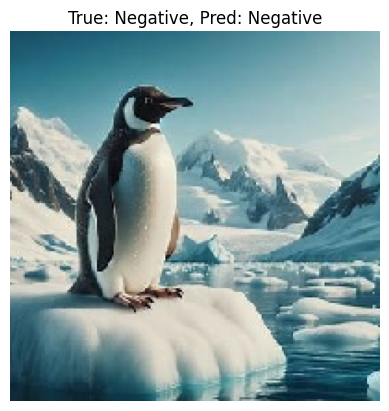

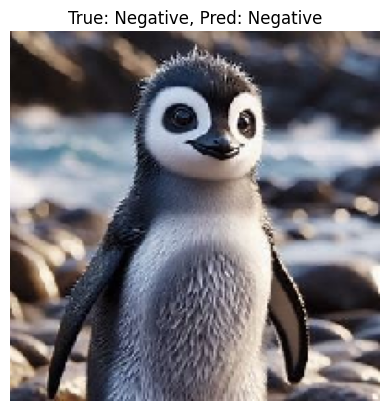

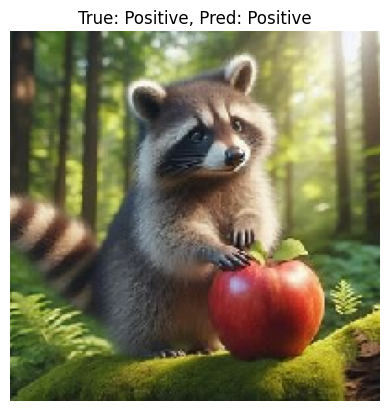

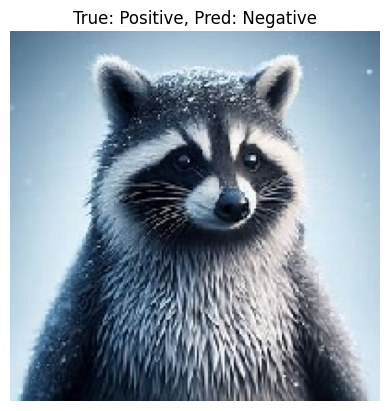

In [5]:
def show_predictions(model, test_iterator):
    test_iterator.reset()
    for i in range(len(test_iterator)):
        images, labels = next(test_iterator)
        predictions = model.predict(images)
        for j in range(len(images)):
            pyplot.imshow(images[j])
            true_label = 'Positive' if labels[j] == 1 else 'Negative'
            predicted_label = 'Positive' if predictions[j] > 0.5 else 'Negative'
            pyplot.title(f"True: {true_label}, Pred: {predicted_label}")
            pyplot.axis('off')
            pyplot.show()

# Run the test harness for evaluating the model
def run_test_harness():
    # Define model
    model = define_model()

    # Create data generator
    datagen = ImageDataGenerator(rescale=1.0 / 255.0)

    # Prepare iterators

    test_it = datagen.flow_from_directory('/content/Generate/Generate/test',
                                          class_mode='binary', batch_size=10, target_size=(200, 200),
                                          shuffle=False)  # Shuffle disabled for consistent predictions


    # Show predictions on test data
    show_predictions(model, test_it)

# Entry point, run the test harness
run_test_harness()

VGG (3 BLOCKS)

Found 4 images belonging to 2 classes.
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


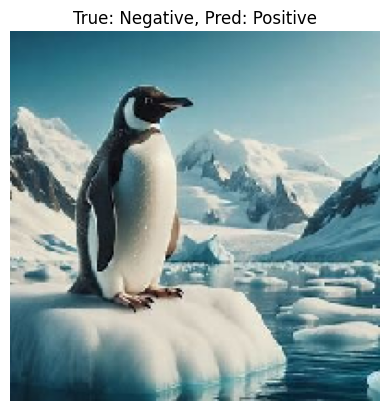

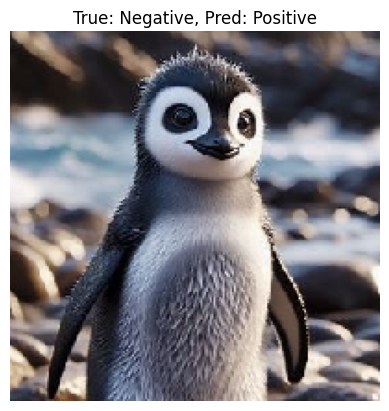

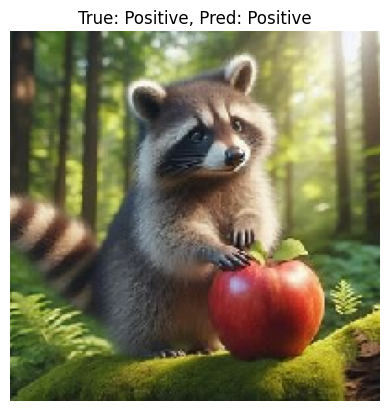

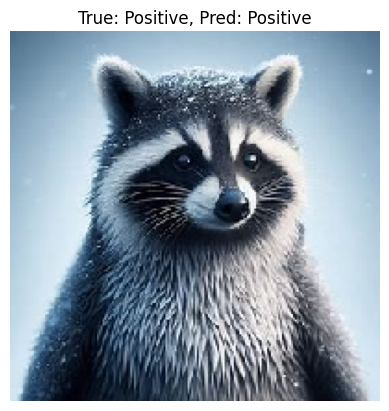

In [14]:
def show_predictions(model, test_iterator):
    test_iterator.reset()
    for i in range(len(test_iterator)):
        images, labels = next(test_iterator)
        predictions = model.predict(images)
        for j in range(len(images)):
            pyplot.imshow(images[j])
            true_label = 'Positive' if labels[j] == 1 else 'Negative'
            predicted_label = 'Positive' if predictions[j] > 0.5 else 'Negative'
            pyplot.title(f"True: {true_label}, Pred: {predicted_label}")
            pyplot.axis('off')
            pyplot.show()

# Run the test harness for evaluating the model
def run_test_harness():
    # Define model
    model = VGG3()

    # Create data generator
    datagen = ImageDataGenerator(rescale=1.0 / 255.0)

    # Prepare iterators

    test_it = datagen.flow_from_directory('/content/Generate/Generate/test',
                                          class_mode='binary', batch_size=10, target_size=(200, 200),
                                          shuffle=False)  # Shuffle disabled for consistent predictions


    # Show predictions on test data
    show_predictions(model, test_it)

# Entry point, run the test harness
run_test_harness()

Found 4 images belonging to 2 classes.


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


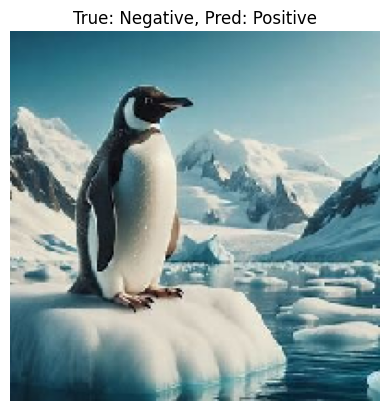

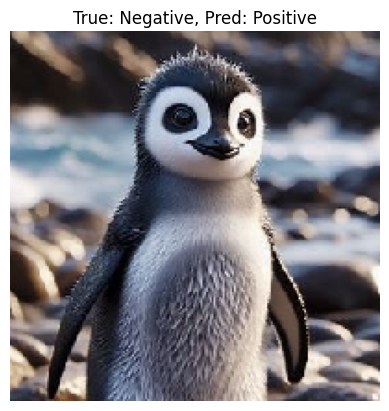

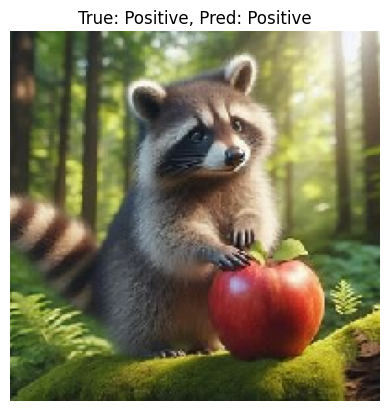

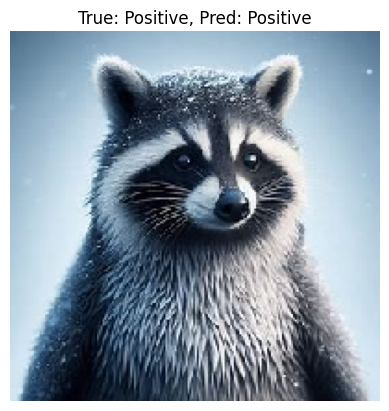

In [15]:

def show_predictions(model, test_iterator):
    test_iterator.reset()
    for i in range(len(test_iterator)):
        images, labels = next(test_iterator)
        predictions = model.predict(images)
        for j in range(len(images)):
            pyplot.imshow(images[j])
            true_label = 'Positive' if labels[j] == 1 else 'Negative'
            predicted_label = 'Positive' if predictions[j] > 0.5 else 'Negative'
            pyplot.title(f"True: {true_label}, Pred: {predicted_label}")
            pyplot.axis('off')
            pyplot.show()

# Run the test harness for evaluating the model
def run_test_harness():
    # Define model
    model = define_vgg_model()

    # Create data generator
    datagen = ImageDataGenerator(rescale=1.0 / 255.0)

    # Prepare iterators

    test_it = datagen.flow_from_directory('/content/Generate/Generate/test',
                                          class_mode='binary', batch_size=10, target_size=(200, 200),
                                          shuffle=False)  # Shuffle disabled for consistent predictions


    # Show predictions on test data
    show_predictions(model, test_it)

# Entry point, run the test harness
run_test_harness()

Found 4 images belonging to 2 classes.


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


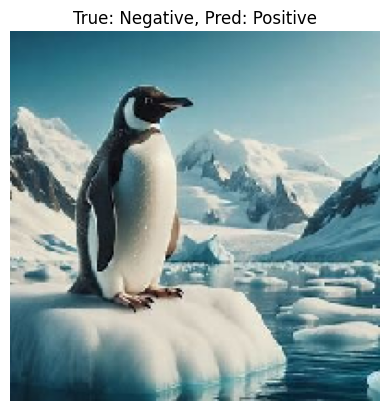

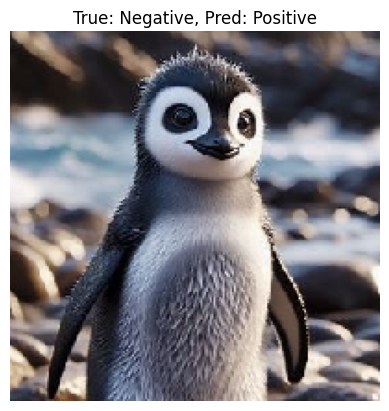

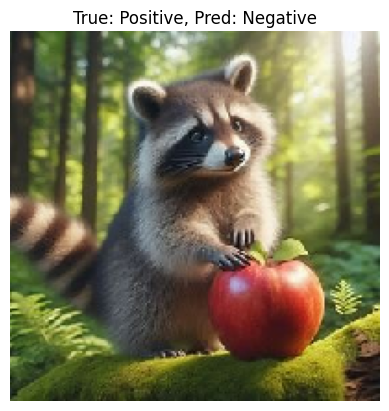

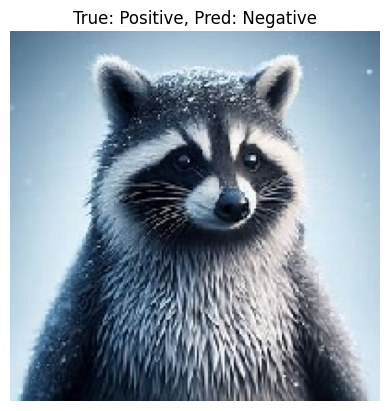

In [16]:
def show_predictions(model, test_iterator):
    test_iterator.reset()
    for i in range(len(test_iterator)):
        images, labels = next(test_iterator)
        predictions = model.predict(images)
        for j in range(len(images)):
            pyplot.imshow(images[j])
            true_label = 'Positive' if labels[j] == 1 else 'Negative'
            predicted_label = 'Positive' if predictions[j] > 0.5 else 'Negative'
            pyplot.title(f"True: {true_label}, Pred: {predicted_label}")
            pyplot.axis('off')
            pyplot.show()

# Run the test harness for evaluating the model
def run_test_harness():
    # Define model
    model = VGG_FINE_TUNE()

    # Create data generator
    datagen = ImageDataGenerator(rescale=1.0 / 255.0)

    # Prepare iterators

    test_it = datagen.flow_from_directory('/content/Generate/Generate/test',
                                          class_mode='binary', batch_size=10, target_size=(200, 200),
                                          shuffle=False)  # Shuffle disabled for consistent predictions


    # Show predictions on test data
    show_predictions(model, test_it)

# Entry point, run the test harness
run_test_harness()

Found 4 images belonging to 2 classes.
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


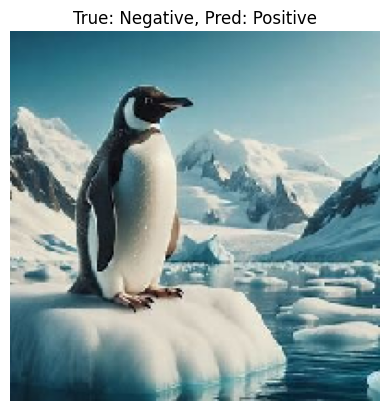

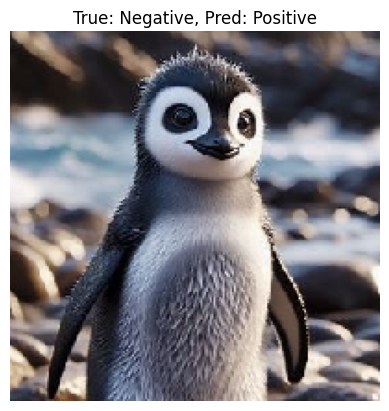

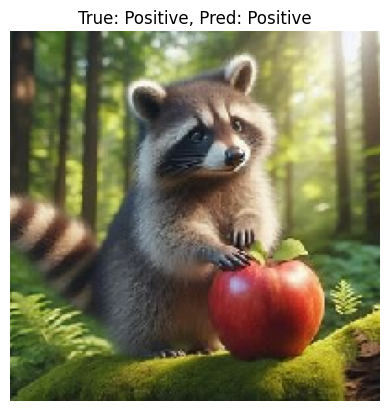

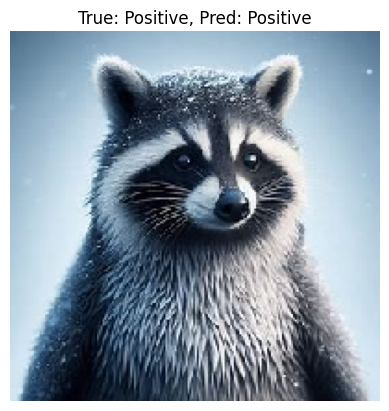

In [19]:
def show_predictions(model, test_iterator):
    test_iterator.reset()
    for i in range(len(test_iterator)):
        images, labels = next(test_iterator)
        predictions = model.predict(images)
        for j in range(len(images)):
            pyplot.imshow(images[j])
            true_label = 'Positive' if labels[j] == 1 else 'Negative'
            predicted_label = 'Positive' if predictions[j] > 0.5 else 'Negative'
            pyplot.title(f"True: {true_label}, Pred: {predicted_label}")
            pyplot.axis('off')
            pyplot.show()

# Run the test harness for evaluating the model
def run_test_harness():
    # Define model
    model = define_mlp_model()

    # Create data generator
    datagen = ImageDataGenerator(rescale=1.0 / 255.0)

    # Prepare iterators

    test_it = datagen.flow_from_directory('/content/Generate/Generate/test',
                                          class_mode='binary', batch_size=10, target_size=(200, 200),
                                          shuffle=False)  # Shuffle disabled for consistent predictions


    # Show predictions on test data
    show_predictions(model, test_it)

# Entry point, run the test harness
run_test_harness()